In [129]:
import numpy as np
import scipy
import matplotlib.pyplot as plt
import matplotlib
from mpl_toolkits.axes_grid1 import make_axes_locatable

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE,MDS
from sklearn.metrics.pairwise import cosine_similarity
import ase.io
import os
import copy
from IPython.display import clear_output
from matplotlib.ticker import NullLocator


In [49]:
import mplhep as hep
plt.style.use(hep.style.ROOT)
matplotlib.rcParams.update({'font.size': 18})

# Calculations

In [15]:
#pos 1 and pos 2 are N by 3 matrices with positions of neighbor atoms


#delta y should be relative change of each position in the descriptor
#delta x should be relative change of position displacement
def condition_number(desc1,desc2,pos1,pos2,verbose = False):
    #print(desc1.shape)
    
    if verbose:
        print("desc1:",desc1.shape,desc1)
        print("desc2:",desc2.shape,desc2)
    
    difference = np.linalg.norm(desc1-desc2,ord = 2)
    delta_y = difference/np.linalg.norm((desc1),ord = 2)
    
    if verbose:
        print("diff",difference)
        print("norm_y",np.linalg.norm(desc1,ord = 2))
        print("delta_y",delta_y)
    
    coordinate_diff = pos2-pos1
    magnitude_diff = np.linalg.norm(pos2-pos1,ord = 2)
    magnitude = np.linalg.norm(pos1,ord = 2)
    
    if verbose:
        print("coord_diff",coordinate_diff)
        print("magnitude_diff",magnitude_diff)
        print("norm_x",magnitude)

    divided = np.divide(magnitude_diff,magnitude)
    delta_x = divided
    
    
    if verbose:
        print("elementwise divide",divided)
        print("delta_x",delta_x)
    
    return delta_y/delta_x

# Plots

In [148]:
#Cosine similarity
def cosine_similarity_heatmap(descriptor_matrix,delta_array,mols,title,savename,savepath):
    colormap = "viridis"
    
    #sensitivity for each basis set for the L parameter and the N parameter (and the r cutoff parameter as a third test?)
    fig,axs = plt.subplots(1,4,figsize=(20,6))
    #https://stackoverflow.com/questions/32462881/add-colorbar-to-existing-axis
    
    #divider = make_axes_locatable(axs[-1])
    cax = axs[-1]         #divider.append_axes('right', size='5%', pad=0.1)
    fig.suptitle(title,fontsize = 18)
    #normalized_conditioning = (condition_matrix - np.min(condition_matrix))/(np.max(condition_matrix)-np.min(condition_matrix))
    plt.subplots_adjust(wspace = 0.26)
    cosine_matrix = np.zeros((4,len(delta_array),len(delta_array)))
    #print(descriptor_matrix["CO2"],descriptor_matrix["H2O"])
    for i in range(len(squish_array)):
        for j in range(len(squish_array)):
            cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
            cosine_matrix[1][i][j] = cosine_similarity([descriptor_matrix["H2O"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
            cosine_matrix[2][i][j] = cosine_similarity([descriptor_matrix["N2"][i]],Y = [descriptor_matrix["N2"][j]])[0]
            cosine_matrix[3][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
    
    #print(normalized_conditioning)
    
    titles = ["CO2","H2O","N2","CO2 vs H2O"]
    x_labels = ["CO2 descriptor","H2O descriptor","N2 descriptor","H2O descriptor"]
    y_labels = ["CO2 descriptor","H2O descriptor","N2 descriptor","CO2 descriptor"]
    
    for i in range(4):
        

        #https://matplotlib.org/stable/gallery/images_contours_and_fields/image_annotated_heatmap.html
        im = axs[i].imshow(cosine_matrix[i],vmin = 0,vmax = 1,cmap = colormap)
        #axs[i].scatter(magnitude,conditioning,color = "cornflowerblue")
        # Show all ticks and label them with the respective list entries
        #if labels
        axs[i].xaxis.set_minor_locator(NullLocator())
        axs[i].yaxis.set_minor_locator(NullLocator())
        axs[i].set_xticks(np.arange(0,len(delta_array),3), labels=delta_array[::3],rotation = 40)
        axs[i].set_yticks(np.arange(0,len(delta_array),3), labels=delta_array[::3])
        axs[i].set_xlabel(x_labels[i])
        if i == 0:
            axs[i].set_ylabel(y_labels[i])
    
        axs[i].set_title(titles[i])
        
    cbar_ticks = [0.0,0.2,0.4,0.6,0.8,1.0]
    sm = plt.cm.ScalarMappable(cmap=colormap)
    fig.subplots_adjust(right=0.75)
    cbar_ax = fig.add_axes([0.77, 0.25, 0.02, 0.5])
    cbar = fig.colorbar(sm, cax=cbar_ax)
    cbar.set_ticks(cbar_ticks)

    plt.savefig(savepath+savename+".png",dpi=300)
    
    return

In [303]:
#Cosine similarity
def cosine_similarity_heatmap_v3(descriptor_matrix,bases,bases_names,delta_array,mols,title,savename,savepath):
    colormap = "viridis"
    ticks = [0,5,9,16,20,25]
    #sensitivity for each basis set for the L parameter and the N parameter (and the r cutoff parameter as a third test?)
    fig,axs = plt.subplots(3,2,figsize=(14,19))
    #https://stackoverflow.com/questions/32462881/add-colorbar-to-existing-axis
    
    #divider = make_axes_locatable(axs[-1])
    #cax = axs[-1]         #divider.append_axes('right', size='5%', pad=0.1)
    #fig.suptitle(title,fontsize = 18)
    #normalized_conditioning = (condition_matrix - np.min(condition_matrix))/(np.max(condition_matrix)-np.min(condition_matrix))
    plt.subplots_adjust(wspace = 0.26)
    cosine_matrix = np.zeros((2,3,len(delta_array),len(delta_array)))
    #print(descriptor_matrix["CO2"],descriptor_matrix["H2O"])
    for axis,basis in enumerate(bases):
        for i in range(len(squish_array)):
            for j in range(len(squish_array)):
                cosine_matrix[axis][0][i][j] = cosine_similarity([descriptor_matrix[basis]["CO2"][i]],Y = [descriptor_matrix[basis]["CO2"][j]])[0]
                cosine_matrix[axis][1][i][j] = cosine_similarity([descriptor_matrix[basis]["H2O"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
                cosine_matrix[axis][2][i][j] = cosine_similarity([descriptor_matrix[basis]["CO2"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
    
    #print(normalized_conditioning)
    
    titles = [r"CO$_2$",r"H$_2$O",r"CO$_2$ vs H$_2$O"]
    x_labels = [r"CO$_2$ descriptor",r"H$_2$O descriptor","H$_2$O descriptor"]
    y_labels = [r"CO$_2$ descriptor",r"H$_2$O descriptor","CO$_2$ descriptor"]
    for j,basis in enumerate(bases_names):
        for i in range(3):


            #https://matplotlib.org/stable/gallery/images_contours_and_fields/image_annotated_heatmap.html
            im = axs[i][j].imshow(cosine_matrix[j][i],vmin = 0,vmax = 1,cmap = colormap)
            #axs[i].scatter(magnitude,conditioning,color = "cornflowerblue")
            # Show all ticks and label them with the respective list entries
            #if labels
            axs[i][j].xaxis.set_minor_locator(NullLocator())
            axs[i][j].yaxis.set_minor_locator(NullLocator())
            axs[i][j].set_xticks(ticks, labels=np.array(delta_array)[ticks],rotation = 40,fontsize = 18)
            axs[i][j].set_yticks(ticks, labels=np.array(delta_array)[ticks],fontsize = 18)
            axs[i][j].xaxis.set_tick_params(width=0,length=0,direction='out')
            axs[i][j].yaxis.set_tick_params(width=0,length=0,direction='out')
            for axis in ["bottom","top","left","right"]:
                axs[i][j].spines[axis].set_linewidth(0.0)
            axs[i][j].set_xlabel(x_labels[i],fontsize = 18)
            #if j == 0:
            axs[i][j].set_ylabel(y_labels[i],fontsize = 18)

            axs[i][j].set_title(titles[i],fontsize = 20)
        
    cbar_ticks = [0.0,0.2,0.4,0.6,0.8,1.0]
    sm = plt.cm.ScalarMappable(cmap=colormap)
    fig.subplots_adjust(right=0.75)
    cbar_ax = fig.add_axes([0.77, 0.25, 0.02, 0.5])
    cbar = fig.colorbar(sm, cax=cbar_ax)
    #cbar.set_ticks(cbar_ticks,fontsize = 20)

    plt.savefig(savepath+savename+".png",dpi=300)
    
    return

In [13]:
#Squish vs basis plots.
def condition_dependence(conditioning,magnitude,title,savepath):
    fig,axs = plt.subplots(1,1,figsize=(5,5))
    
    
    axs.scatter(magnitude,conditioning,color = "cornflowerblue")
    
    axs.set_xlabel("Magnitude of perturbation")
    axs.set_ylabel("Relative condition number")
    
    axs.set_title(title)
    if max(conditioning) < 4:
        axs.set_ylim(0,5)
    for axis in ["bottom","top","left","right"]:
        axs.spines[axis].set_linewidth(2.0)
    
    axs.xaxis.set_tick_params(width=2,length=5)
    axs.yaxis.set_tick_params(width=2,length=5)
    plt.savefig(savepath+title+".png",dpi=300)

In [75]:
#Expects 9 bases,
#plots the squish vs basis for a given system, chosen N max, L max, cutoff
def condition_dependence_matrix(conditioning_matrix,delta_array,global_title,subtitles,savename,savepath,color = None):
    if color is None:
        color = "cornflowerblue"
        
    fig,axs = plt.subplots(3,3,figsize=(15,15),sharex = True,sharey = True)
    fig.suptitle(global_title,fontsize = 18)
    
    #normalized_conditioning = (condition_matrix - np.min(condition_matrix))/(np.max(condition_matrix)-np.min(condition_matrix))
    #print(normalized_conditioning)
    counter_x = 0
    counter_y = 0
    for i,basis in enumerate(bases):
           
        axs[counter_x,counter_y].scatter(delta_array,conditioning_matrix[i],color = color)
    
        #axs[counter_x,counter_y].set_xlabel()
        #axs[counter_x,counter_y].set_ylabel()
        axs[counter_x,counter_y].set_title(subtitles[i])
        
        if counter_y == 0:
            axs[counter_x,counter_y].set_ylabel("Relative condition number")   
        if counter_x == 2:
            axs[counter_x,counter_y].set_xlabel("Magnitude of perturbation")
        #axs[counter_x,counter_y].set_aspect('equal')
        counter_y += 1
        if counter_y == 3:
            counter_y = 0
            counter_x += 1
    
    plt.savefig(savepath+savename+".png",dpi=300)
    plt.close()
    

In [105]:
#Condition matrix and variances should be [nbases,len(Lmax),len(N_max)]
#Expects 9 bases
def sensitivity_heatmap(condition_matrix,N_max_array,L_max_array,global_title,subtitles,savename,savepath,variances = 0):
    colormap = "viridis"
    
    #sensitivity for each basis set for the L parameter and the N parameter (and the r cutoff parameter as a third test?)
    fig,axs = plt.subplots(3,3,figsize=(15,15))

    fig.suptitle(title,fontsize = 18)
    #print("test",np.min(condition_matrix),np.max(condition_matrix))
    normalized_conditioning = copy.deepcopy((condition_matrix - np.min(condition_matrix))/(np.max(condition_matrix)-np.min(condition_matrix)))
    
    #print(normalized_conditioning.shape)
    
    counter_x = 0
    counter_y = 0
    ims = []
    for i,basis in enumerate(subtitles):
        #print(i)
        #print(normalized_conditioning[i])
        #https://matplotlib.org/stable/gallery/images_contours_and_fields/image_annotated_heatmap.html
        ims.append(axs[counter_x,counter_y].imshow(normalized_conditioning[i],vmin = 0,vmax = 1,cmap = colormap))
        #axs[i].scatter(magnitude,conditioning,color = "cornflowerblue")
        # Show all ticks and label them with the respective list entries
        
        #May need to skip every other one
        axs[counter_x,counter_y].set_xticks(np.arange(len(N_max_array)), labels=N_max_array)
        axs[counter_x,counter_y].set_yticks(np.arange(len(L_max_array)), labels=L_max_array)
        #axs[counter_x,counter_y].set_xlabel("N_max")
        if counter_y == 0:
            axs[counter_x,counter_y].set_ylabel("L max")
        if counter_x == 2:
            axs[counter_x,counter_y].set_xlabel("Number of basis functions")
    
        axs[counter_x,counter_y].set_title(subtitles[i])
        axs[counter_x,counter_y].set_aspect('equal')
        counter_y += 1
        if counter_y == 3:
            counter_y = 0
            counter_x += 1
        
    cbar_ticks = [0.0,0.2,0.4,0.6,0.8,1.0]
    #cbar = fig.colorbar(im, cax=cax, ticks = cbar_ticks,orientation='vertical')
    cbar_tick_labels = []
    for tick in cbar_ticks:
        cbar_tick_labels.append(round(tick*(np.max(condition_matrix)-np.min(condition_matrix))+np.min(condition_matrix),2))
    #cbar.ax.set_yticklabels(cbar_tick_labels)
    #cbar.TickLabelFormat = '%.2f'
    sm = plt.cm.ScalarMappable(cmap=colormap)
    fig.subplots_adjust(right=0.75)
    cbar_ax = fig.add_axes([0.8, 0.25, 0.02, 0.5])
    cbar = fig.colorbar(sm, cax=cbar_ax)
    cbar.set_ticks([0.0,0.2,0.4,0.6,0.8,1.0])
    cbar.set_ticklabels(cbar_tick_labels)
    
    plt.savefig(savepath+savename+".png",dpi=300)

In [258]:
def sensitivity_heatmap_v3(condition_matrix,N_max_array,L_max_array,global_title,subtitles,savename,savepath,variances = 0):
    colormap = "viridis"
    
    #sensitivity for each basis set for the L parameter and the N parameter (and the r cutoff parameter as a third test?)
    fig,axs = plt.subplots(3,3,figsize=(15,15))

    #fig.suptitle(title,fontsize = 18)
    #print("test",np.min(condition_matrix),np.max(condition_matrix))
    normalized_conditioning = copy.deepcopy((condition_matrix - np.min(condition_matrix))/(np.max(condition_matrix)-np.min(condition_matrix)))
    
    #print(normalized_conditioning.shape)
    
    counter_x = 0
    counter_y = 0
    ims = []
    for i,basis in enumerate(subtitles):
        #print(i)
        #print(normalized_conditioning[i])
        #https://matplotlib.org/stable/gallery/images_contours_and_fields/image_annotated_heatmap.html
        ims.append(axs[counter_x,counter_y].imshow(normalized_conditioning[i].T,vmin = 0,vmax = 1,cmap = colormap))
        #axs[i].scatter(magnitude,conditioning,color = "cornflowerblue")
        # Show all ticks and label them with the respective list entries
        
        #May need to skip every other one
        axs[counter_x,counter_y].xaxis.set_minor_locator(NullLocator())
        axs[counter_x,counter_y].yaxis.set_minor_locator(NullLocator())
        axs[counter_x,counter_y].xaxis.set_tick_params(width=0,length=0,direction='out')
        axs[counter_x,counter_y].yaxis.set_tick_params(width=0,length=0,direction='out')
        for axis in ["bottom","top","left","right"]:
            axs[counter_x,counter_y].spines[axis].set_linewidth(0.0)
        axs[counter_x,counter_y].set_yticks(np.arange(0,len(N_max_array),2), labels=N_max_array[::2],fontsize = 20)
        axs[counter_x,counter_y].set_xticks(np.arange(0,len(L_max_array),2), labels=L_max_array[::2],fontsize = 20)
        #axs[counter_x,counter_y].set_xlabel("N_max")
        if counter_y == 0:
            axs[counter_x,counter_y].set_ylabel(r"$N_{max}$",fontsize = 24)
        if counter_x == 2:
            axs[counter_x,counter_y].set_xlabel(r"$L_{max}$",fontsize = 24)
    
        axs[counter_x,counter_y].set_title(subtitles[i],fontsize = 24)
        axs[counter_x,counter_y].set_aspect('equal')
        counter_y += 1
        if counter_y == 3:
            counter_y = 0
            counter_x += 1
        
    cbar_ticks = [0.0,0.2,0.4,0.6,0.8,1.0]
    #cbar = fig.colorbar(im, cax=cax, ticks = cbar_ticks,orientation='vertical')
    cbar_tick_labels = []
    for tick in cbar_ticks:
        cbar_tick_labels.append(round(tick*(np.max(condition_matrix)-np.min(condition_matrix))+np.min(condition_matrix),2))
    #cbar.ax.set_yticklabels(cbar_tick_labels)
    #cbar.TickLabelFormat = '%.2f'
    sm = plt.cm.ScalarMappable(cmap=colormap)
    fig.subplots_adjust(right=0.75)
    cbar_ax = fig.add_axes([0.8, 0.25, 0.02, 0.5])
    cbar = fig.colorbar(sm, cax=cbar_ax)
    cbar.set_ticks([0.0,0.2,0.4,0.6,0.8,1.0])
    cbar.set_ticklabels(cbar_tick_labels,fontsize = 24)
    
    plt.savefig(savepath+savename+".png",dpi=300)

In [284]:
def fourier(basis_vals, basis_derivs, r, N, radial_hyps):
    r1 = radial_hyps[0]
    r2 = radial_hyps[1]
    c = 1 / (r2 - r1)
    x = (r - r1) * c
    fourier_factor = radial_hyps[2]

    # If r is outside the support of the radial basis set, return.
    if r < r1 or r > r2:
        return

    cos_count = 1
    sin_count = 1
    for n in range(N):
        if n == 0:
            basis_vals[n] = 1
            basis_derivs[n] = 0
        elif n % 2 == 1:
            c2 = math.pi * fourier_factor * cos_count
            basis_vals[n] = math.cos(c2 * x)
            basis_derivs[n] = -math.sin(c2 * x) * c2 * c
            cos_count += 1
        elif n % 2 == 0:
            c2 = math.pi * fourier_factor * sin_count
            basis_vals[n] = math.sin(c2 * x)
            basis_derivs[n] = math.cos(c2 * x) * c2 * c
            sin_count += 1

import math
import numpy as np

def fourier_quarter(basis_vals, basis_derivs, r, N, radial_hyps):
    r1 = radial_hyps[0]
    r2 = radial_hyps[1]
    c = 1 / (r2 - r1)
    x = (r - r1) * c

    # If r is outside the support of the radial basis set, return.
    if r < r1 or r > r2:
        return

    cos_count = 1
    sin_count = 1
    for n in range(N):
        if n == 0:
            basis_vals[n] = 1
            basis_derivs[n] = 0
        elif n % 2 == 1:
            c2 = (math.pi / 2) * cos_count
            basis_vals[n] = math.cos(c2 * x)
            basis_derivs[n] = -math.sin(c2 * x) * c2 * c
            cos_count += 1
        elif n % 2 == 0:
            c2 = (math.pi / 2) * sin_count
            basis_vals[n] = math.sin(c2 * x)
            basis_derivs[n] = math.cos(c2 * x) * c2 * c
            sin_count += 1

def fourier_half(basis_vals, basis_derivs, r, N, radial_hyps):
    r1 = radial_hyps[0]
    r2 = radial_hyps[1]
    c = 1 / (r2 - r1)
    x = (r - r1) * c

    # If r is outside the support of the radial basis set, return.
    if r < r1 or r > r2:
        return

    cos_count = 1
    sin_count = 1
    for n in range(N):
        if n == 0:
            basis_vals[n] = 1
            basis_derivs[n] = 0
        elif n % 2 == 1:
            c2 = math.pi * cos_count
            basis_vals[n] = math.cos(c2 * x)
            basis_derivs[n] = -math.sin(c2 * x) * c2 * c
            cos_count += 1
        elif n % 2 == 0:
            c2 = math.pi * sin_count
            basis_vals[n] = math.sin(c2 * x)
            basis_derivs[n] = math.cos(c2 * x) * c2 * c
            sin_count += 1

def bessel(basis_vals, basis_derivs, r, N, radial_hyps):
    r1 = radial_hyps[0]
    r2 = radial_hyps[1]
    c = r2 - r1
    c1 = np.sqrt(2 / c)
    d = r - r1

    # If r is outside the support of the radial basis set, return.
    if r < r1 or r > r2:
        return

    for n in range(N):
        c2 = math.pi * (n + 1) * d
        c3 = c2 / c
        c4 = c * d * d
        basis_vals[n] = c1 * np.sin(c3) / d
        basis_derivs[n] = c1 * (c2 * np.cos(c3) - c * np.sin(c3)) / c4

def chebyshev(basis_vals, basis_derivs, r, N, radial_hyps):
    r1 = radial_hyps[0]
    r2 = radial_hyps[1]

    # If r is outside the support of the radial basis set, return.
    if r < r1 or r > r2:
        return

    c = 1 / (r2 - r1)
    x = (r - r1) * c

    for n in range(N):
        if n == 0:
            basis_vals[n] = 1
            basis_derivs[n] = 0
        elif n == 1:
            basis_vals[n] = x
            basis_derivs[n] = c
        else:
            basis_vals[n] = 2 * x * basis_vals[n - 1] - basis_vals[n - 2]
            basis_derivs[n] = 2 * basis_vals[n - 1] * c + 2 * x * basis_derivs[n - 1] - basis_derivs[n - 2]

def positive_chebyshev(basis_vals, basis_derivs, r, N, radial_hyps):
    r1 = radial_hyps[0]
    r2 = radial_hyps[1]

    # If r is outside the support of the radial basis set, return.
    if r < r1 or r > r2:
        return

    cheby_vals = np.zeros(N)
    cheby_derivs = np.zeros(N)

    c = 1 / (r2 - r1)
    x = (r - r1) * c
    half = 1. / 2.

    for n in range(N):
        if n == 0:
            cheby_vals[n] = 1
            cheby_derivs[n] = 0

            basis_vals[n] = 1
            basis_derivs[n] = 0
        elif n == 1:
            cheby_vals[n] = x
            cheby_derivs[n] = c

            basis_vals[n] = half * (1 - x)
            basis_derivs[n] = -half * c
        else:
            cheby_vals[n] = 2 * x * cheby_vals[n - 1] - cheby_vals[n - 2]
            cheby_derivs[n] = 2 * cheby_vals[n - 1] * c + 2 * x * cheby_derivs[n - 1] - cheby_derivs[n - 2]

            basis_vals[n] = half * (1 - cheby_vals[n])
            basis_derivs[n] = -half * cheby_derivs[n]

def weighted_chebyshev(basis_vals, basis_derivs, r, N, radial_hyps):
    r1 = radial_hyps[0]
    r2 = radial_hyps[1]
    lambda_val = radial_hyps[2]

    # If r is outside the support of the radial basis set, return.
    if r < r1 or r > r2:
        return

    c = 1 / (r2 - r1)
    x = (r - r1) * c
    exp_const = np.exp(-lambda_val * (x - 1))
    lambda_const = np.exp(lambda_val) - 1
    x_weighted = 1 - 2 * (exp_const - 1) / lambda_const
    dx_dr = 2 * c * lambda_val * exp_const / lambda_const
    half = 1. / 2.

    cheby_vals = np.zeros(N)
    cheby_derivs = np.zeros(N)

    for n in range(N):
        if n == 0:
            cheby_vals[n] = 1
            cheby_derivs[n] = 0

            basis_vals[n] = 1
            basis_derivs[n] = 0
        elif n == 1:
            cheby_vals[n] = x_weighted
            cheby_derivs[n] = 1

            basis_vals[n] = cheby_vals[n]
            basis_derivs[n] = cheby_derivs[n] * dx_dr
        else:
            cheby_vals[n] = 2 * x_weighted * cheby_vals[n - 1] - cheby_vals[n - 2]
            cheby_derivs[n] = 2 * cheby_vals[n - 1] + 2 * x_weighted * cheby_derivs[n - 1] - cheby_derivs[n - 2]

            basis_vals[n] = cheby_vals[n]
            basis_derivs[n] = cheby_derivs[n] * dx_dr

def weighted_positive_chebyshev(basis_vals, basis_derivs, r, N, radial_hyps):
    r1 = radial_hyps[0]
    r2 = radial_hyps[1]
    lambda_val = radial_hyps[2]

    # If r is outside the support of the radial basis set, return.
    if r < r1 or r > r2:
        return

    c = 1 / (r2 - r1)
    x = (r - r1) * c
    exp_const = np.exp(-lambda_val * (x - 1))
    lambda_const = np.exp(lambda_val) - 1
    x_weighted = 1 - 2 * (exp_const - 1) / lambda_const
    dx_dr = 2 * c * lambda_val * exp_const / lambda_const
    half = 1. / 2.

    cheby_vals = np.zeros(N)
    cheby_derivs = np.zeros(N)

    for n in range(N):
        if n == 0:
            cheby_vals[n] = 1
            cheby_derivs[n] = 0

            basis_vals[n] = 1
            basis_derivs[n] = 0
        elif n == 1:
            cheby_vals[n] = x_weighted
            cheby_derivs[n] = 1

            basis_vals[n] = half * (1 - x_weighted)
            basis_derivs[n] = -half * dx_dr
        else:
            cheby_vals[n] = 2 * x_weighted * cheby_vals[n - 1] - cheby_vals[n - 2]
            cheby_derivs[n] = 2 * cheby_vals[n - 1] + 2 * x_weighted * cheby_derivs[n - 1] - cheby_derivs[n - 2]

            basis_vals[n] = half * (1 - cheby_vals[n])
            basis_derivs[n] = -half * cheby_derivs[n] * dx_dr

def equispaced_gaussians(basis_vals, basis_derivs, r, N, radial_hyps):
    sigma = radial_hyps[2]
    first_gauss = radial_hyps[0]
    final_gauss = radial_hyps[1]
    gauss_sep = final_gauss - first_gauss

    norm_factor = 1 / (sigma * np.sqrt(2 * math.pi))
    sig2 = 1 / (sigma * sigma)
    half_sig2 = sig2 / 2

    for n in range(N):
        mean_val = first_gauss + (n * gauss_sep / (N - 1))
        mean_diff = r - mean_val
        exp_arg = -half_sig2 * mean_diff * mean_diff
        gn_val = norm_factor * np.exp(exp_arg)
        basis_vals[n] = gn_val
        basis_derivs[n] = -sig2 * gn_val * mean_diff

def poly(basis_vals, basis_derivs, r, N, radial_hyps):
    r1 = radial_hyps[0]
    r2 = radial_hyps[1]

    # If r is outside the support of the radial basis set, return.
    if r < r1 or r > r2:
        return

    c = 1 / (r2 - r1)
    x = (r - r1) * c
    
    for n in range(N):
        basis_vals[n] = x**n
        basis_derivs[n] = n*x**(n-1)
        
def compute_basis(basis_vals,basis_derivs,r,N, cutoff, func, radial_hyps):
    
    #xarr = np.linspace(0.01, 1, m)
    
    #basis_vals = np.zeros((N,m))
    #basis_derivs = np.zeros((N,m))
    
    #rcut_vals = np.zeros((2,m))
    print(r)
    for i,x in enumerate(r):
        func(basis_vals[:,i], basis_derivs[:,i], x, N, radial_hyps)

        # calculate cutoff values
        #quadratic_cutoff(rcut_vals[:,i], x, cutoff)
    
    #return basis_derivs
def compute_basis_derivs(m, N, cutoff, func, radial_hyps):
    
    xarr = np.linspace(0.01, 1, m)
    
    basis_vals = np.zeros((N,m))
    basis_derivs = np.zeros((N,m))
    
    rcut_vals = np.zeros((2,m))

    for i, x in enumerate(xarr):
        # calculate basis
        func(basis_vals[:,i], basis_derivs[:,i], x, N, radial_hyps)

        # calculate cutoff values
        quadratic_cutoff(rcut_vals[:,i], x, cutoff)
    
    return xarr, basis_derivs, rcut_vals

def quadratic_cutoff(rcut_vals, r, rcut):
    if (r > rcut):
        rcut_vals[0] = 0
        rcut_vals[1] = 0
        return

    rdiff = r - rcut
    rcut_vals[0] = rdiff * rdiff
    rcut_vals[1] = 2 * rdiff

def plot_all(functions, titles, radial_hyps, isEnvelope, save_path, m = 100, N = 100, cutoff = 1):

    _, axs = plt.subplots(1, len(functions), sharey=True, figsize = (15, 5))
    colors = ['#762a83', '#af8dc3', '#e7d4e8', '#7fbf7b', '#1b7837' ]
    min_data_ratio = 1000
    max_data_ratio = 0
    for ax, func, title in zip (axs, functions, titles):
        xarr, basis_vals, rcut_vals = compute_basis_derivs(m, N, cutoff, func, radial_hyps)
        
        for i, c in zip(np.arange(0, 5), colors ):
            if(isEnvelope):
                ax.plot(xarr, basis_vals[i,:]*rcut_vals[0,:], label = '$T_%s$'%(i), color = c)
            else:
                ax.plot(xarr, basis_vals[i,:], label = '$T_%s$'%(i), color = c)
            ax.set_title(title)
            ax.set_xlabel('$r/r_c$')
            if ax.get_data_ratio() < min_data_ratio:
                min_data_ratio = ax.get_data_ratio()
            if ax.get_data_ratio() > max_data_ratio:
                max_data_ratio = ax.get_data_ratio()
                
    for ax in axs:
        ax.set_aspect(1.0/max_data_ratio, adjustable='box')
            
        
    axs[0].legend(loc='center left', bbox_to_anchor=(-0.5, 0.5), ncol=1, frameon=True)
    axs[0].set_ylabel('T') 
    plt.savefig(save_path)
    plt.show()
    
def plot_derivatives(radius,bases,N,cutoff,delta_array,global_title,subtitles,savename,savepath,color = None):
    if color is None:
        color = "cornflowerblue"
        
    fig,axs = plt.subplots(3,3,figsize=(15,15),sharex = True,sharey = True)
    fig.suptitle(global_title,fontsize = 18)
    
    supported_bases = set(["chebyshev","positive_chebyshev","weighted_chebyshev","weighted_positive_chebyshev","fourier","fourier_half","fourier_quarter","equispaced_gaussians","poly"])
    radial_hyps = {}
    radial_hyps["chebyshev"] = [0,cutoff,5]
    radial_hyps["positive_chebyshev"] = [0,cutoff,5]
    radial_hyps["weighted_chebyshev"] = [0,cutoff,5]
    radial_hyps["weighted_positive_chebyshev"] = [0,cutoff,5]
    radial_hyps["fourier"] = [0,cutoff,2]
    radial_hyps["fourier_half"] = [0,cutoff,2]
    radial_hyps["fourier_quarter"] = [0,cutoff,2]
    radial_hyps["equispaced_gaussians"] = [0,cutoff,2]
    radial_hyps["poly"] = [0,cutoff]
    func = {}
    func["chebyshev"] = chebyshev
    func["positive_chebyshev"] = positive_chebyshev
    func["weighted_chebyshev"] = weighted_chebyshev
    func["weighted_positive_chebyshev"] = weighted_positive_chebyshev
    func["fourier"] = fourier
    func["fourier_half"] = fourier_half
    func["fourier_quarter"] = fourier_quarter
    func["poly"] = poly
    func["equispaced_gaussians"] = equispaced_gaussians
    
    
    
    derivatives = {}
    for i,basis in enumerate(supported_bases):
        derivatives[basis] = np.zeros((N,len(radius[i])))
        compute_basis(np.zeros((N,len(radius[i]))),derivatives[basis],radius[i],N,cutoff,func[basis],radial_hyps[basis])
        
    
    
    #normalized_conditioning = (condition_matrix - np.min(condition_matrix))/(np.max(condition_matrix)-np.min(condition_matrix))
    #print(normalized_conditioning)
    counter_x = 0
    counter_y = 0
    for i,basis in enumerate(bases):
        if basis in supported_bases: 
            #print(len(delta_array),np.sum(np.abs(derivatives[basis]),axis = 0).shape)
            axs[counter_x,counter_y].scatter(delta_array,np.sum(np.abs(derivatives[basis]),axis = 0),c = color)
    
        #axs[counter_x,counter_y].set_xlabel()
        #axs[counter_x,counter_y].set_ylabel()
        axs[counter_x,counter_y].set_title(subtitles[i])
        
        if counter_y == 0:
            axs[counter_x,counter_y].set_ylabel("Magnitude of basis derivatives")   
        if counter_x == 2:
            axs[counter_x,counter_y].set_xlabel("Magnitude of perturbation")
        #axs[counter_x,counter_y].set_aspect('equal')
        counter_y += 1
        if counter_y == 3:
            counter_y = 0
            counter_x += 1
    
    plt.savefig(savepath+savename+".png",dpi=300)
    plt.close()

def plot_derivatives_v3(radius,bases,N,cutoff,delta_array,global_title,subtitles,savename,savepath,color = None):
    if color is None:
        color = "cornflowerblue"
        
    fig,axs = plt.subplots(3,3,figsize=(15,15),sharex = True,sharey = True)
    plt.subplots_adjust(wspace=0, hspace=0)
    #fig.suptitle(global_title,fontsize = 18)
    
    supported_bases = set(["chebyshev","positive_chebyshev","weighted_chebyshev","weighted_positive_chebyshev","fourier","fourier_half","fourier_quarter","equispaced_gaussians","poly"])
    radial_hyps = {}
    radial_hyps["chebyshev"] = [0,cutoff,5]
    radial_hyps["positive_chebyshev"] = [0,cutoff,5]
    radial_hyps["weighted_chebyshev"] = [0,cutoff,5]
    radial_hyps["weighted_positive_chebyshev"] = [0,cutoff,5]
    radial_hyps["fourier"] = [0,cutoff,2]
    radial_hyps["fourier_half"] = [0,cutoff,2]
    radial_hyps["fourier_quarter"] = [0,cutoff,2]
    radial_hyps["equispaced_gaussians"] = [0,cutoff,2]
    radial_hyps["poly"] = [0,cutoff]
    func = {}
    func["chebyshev"] = chebyshev
    func["positive_chebyshev"] = positive_chebyshev
    func["weighted_chebyshev"] = weighted_chebyshev
    func["weighted_positive_chebyshev"] = weighted_positive_chebyshev
    func["fourier"] = fourier
    func["fourier_half"] = fourier_half
    func["fourier_quarter"] = fourier_quarter
    func["poly"] = poly
    func["equispaced_gaussians"] = equispaced_gaussians
    
    
    
    derivatives = {}
    for i,basis in enumerate(supported_bases):
        derivatives[basis] = np.zeros((N,len(radius[i])))
        compute_basis(np.zeros((N,len(radius[i]))),derivatives[basis],radius[i],N,cutoff,func[basis],radial_hyps[basis])
        
    
    
    #normalized_conditioning = (condition_matrix - np.min(condition_matrix))/(np.max(condition_matrix)-np.min(condition_matrix))
    #print(normalized_conditioning)
    counter_x = 0
    counter_y = 0
    for i,basis in enumerate(bases):
        if basis in supported_bases: 
            #print(len(delta_array),np.sum(np.abs(derivatives[basis]),axis = 0).shape)
            axs[counter_x,counter_y].scatter(delta_array,np.sum(np.abs(derivatives[basis]),axis = 0),c = color)
    
        #axs[counter_x,counter_y].set_xlabel()
        #axs[counter_x,counter_y].set_ylabel()
        axs[counter_x,counter_y].set_title(subtitles[i],fontsize = 24, y=1.0, pad=-30)
        
        if counter_y == 0:
            axs[counter_x,counter_y].set_ylabel("Derivatives Magnitude",fontsize = 24)   
        if counter_x == 2:
            axs[counter_x,counter_y].set_xlabel("Perturbation",fontsize = 24)
        axs[counter_x,counter_y].set_xticks([delta_array[2],0,delta_array[-3]])
        axs[counter_x,counter_y].tick_params(axis='both', which='major', labelsize=24)

        counter_y += 1
        if counter_y == 3:
            counter_y = 0
            counter_x += 1
    
    plt.savefig(savepath+savename+".png",dpi=300)
    plt.close()
    
def calc_distance(positions):
    difference = positions[:,0]-positions[:,1]
    power = np.power(difference,2)
    distance = np.sqrt(np.sum(power))
    return distance

In [302]:
def condition_dependence_matrix_v3(conditioning_matrix,delta_array,global_title,subtitles,savename,savepath,color = None):
    if color is None:
        color = "cornflowerblue"
        
    fig,axs = plt.subplots(3,3,figsize=(15,15),sharex = True,sharey = True)
    #fig.suptitle(global_title,fontsize = 18)
    plt.subplots_adjust(wspace=0, hspace=0)
    maxvalue = np.max(conditioning_matrix)
    minvalue = 0
    
    #normalized_conditioning = (condition_matrix - np.min(condition_matrix))/(np.max(condition_matrix)-np.min(condition_matrix))
    #print(normalized_conditioning)
    counter_x = 0
    counter_y = 0
    for i,basis in enumerate(bases):
           
        axs[counter_x,counter_y].scatter(delta_array,conditioning_matrix[i],color = color)
    
        #axs[counter_x,counter_y].set_xlabel()
        #axs[counter_x,counter_y].set_ylabel()
        axs[counter_x,counter_y].set_title(subtitles[i],fontsize=24, y=1.0, pad=-30)
        
        if counter_y == 0:
            axs[counter_x,counter_y].set_ylabel("Condition Number",fontsize = 24)   
        if counter_x == 2:
            axs[counter_x,counter_y].set_xlabel("Perturbation",fontsize = 24)
        axs[counter_x,counter_y].set_xticks([delta_array[2],0,delta_array[-3]])
        axs[counter_x,counter_y].tick_params(axis='both', which='major', labelsize=24)
        axs[counter_x,counter_y].set_ylim(minvalue,maxvalue+1)
        #axs[counter_x,counter_y].set_aspect('equal')
        counter_y += 1
        if counter_y == 3:
            counter_y = 0
            counter_x += 1
    
    plt.savefig(savepath+savename+".png",dpi=300)
    plt.close()
    

# Data

In [85]:
ace_directory = '/Users/marcdescoteaux/Documents/04_Courses/AM205_NumMethods/Project/23_12_6_Work/H2O_CO2_ace_cutoff_6/ACE/'
xyz_directory = "../Initial_structures/All_v2/"
bases = ['chebyshev','weighted_chebyshev','positive_chebyshev','weighted_positive_chebyshev', 'poly','equispaced_gaussians', 'fourier','fourier_half', 'fourier_quarter']
conditioning = {"CO2":{},"H2O":{},"N2":{}}
savepath = "./Figures_v2/"

In [287]:
squish_array = [-0.5,-0.45,-0.4,-0.35,-0.3,-0.25,-0.2,-0.15,-0.1,-0.05,-0.025,-0.01,-0.001,0.001,0.01,0.025,0.05,0.1,0.15,0.2,0.25,0.3,0.35,0.4,0.45,0.5]
nudge_array = [-45.0,-30.0,-15.0,-12.5,-10.0,-7.5,-5,-2.5,-1.0,-0.1,-0.05,-0.025,-0.01,0.01,0.025,0.05,0.1,1.0,2.5,5.0,7.5,10.0,12.5,15.0,30.0,45.0]
N_max_array = np.arange(2,22,2)
L_max_array = np.arange(1,11,1)
cutoff_array = [6]
bases_titles = ["Chebyshev","Wt. Chebyshev","Pos. Chebyshev","Wt. Pos. Chebyshev","Monomial","Equispaced Gaussians","Fourier","Half Fourier","Quarter Fourier"]
color_dict = {"CO2":"#1b7837","H2O":"#762a83","N2":None}

In [298]:
cutoff = cutoff_array[0]
plot = True
for mol in ["CO2","H2O","N2"]:
    default_xyz = ase.io.read(xyz_directory+"default_"+mol+".extxyz")
    conditioning[mol] = []#np.zeros((len(bases),len(L_max_array),len(N_max_array)))
    for j,L_max in enumerate(L_max_array):
        conditioning[mol].append([])
        for k,N_max in enumerate(N_max_array):
            conditioning[mol][j].append([])
            for i,basis in enumerate(bases):
                conditioning[mol][j][k].append([])
                filename = ace_directory + "norm_default_"+mol+"_"+basis+"_0_"+str(cutoff)+"_Nmax_"+str(N_max)+"_Lmax_"+str(L_max)+"_cutoff_"+str(cutoff)+".npz"
                default = np.load(filename)["ACE"][0]
                for squish in squish_array:
                    #direction = "+"
                    #if nudge < 0:
                    #    direction = "-"
                    #print(nudge,direction)
                    filename = ace_directory+"norm_bond_delta_"+str(squish*1000.0).split(".")[0]+"_"+mol+"_"+basis+"_0_"+str(cutoff)+"_Nmax_"+str(N_max)+"_Lmax_"+str(L_max)+"_cutoff_"+str(cutoff)+".npz"
                    comparison = np.load(filename)["ACE"][0]
                    #print("desc",default,comparison,comparison.shape)
                    comparison_xyz = ase.io.read(xyz_directory+"bond_delta_"+str(squish*1000.0).split(".")[0]+"_"+mol+".extxyz")
                    conditioning[mol][j][k][i].append(condition_number(default,comparison,default_xyz.positions,comparison_xyz.positions))
                #print("coord",mol,basis,default_xyz.positions,comparison_xyz.positions)
    #print("Mol",mol,"basis",basis,"L_max",L_max,"N_max",N_max,":\n")
    print(conditioning[mol][j][k][i])
    #conditioning_matrix,delta_array,global_title,subtitles,savename,savepath
    if plot:
        for j,L_max in enumerate(L_max_array):
            for k,N_max in enumerate(N_max_array):
                plt.ioff()
                condition_dependence_matrix_v3(conditioning[mol][j][k][:],squish_array,"Bond delta conditioning: "+mol+" L_max:"+str(L_max) +", N_max:"+str(N_max),bases_titles,"Squish_v3_"+mol+"_"+str(L_max) +"_"+str(N_max)+"_"+str(cutoff),"./Figures_v3/",color = color_dict[mol])
                plt.ion()


[2.6844844025292796, 2.7914502284897953, 2.8826908620752376, 2.9531757991836374, 2.9997936602436317, 3.02223422106295, 3.023134168981089, 3.0074235246348264, 2.9811323347070804, 2.9500555685184953, 2.9341850958384708, 2.924797543922598, 2.9192453952019153, 2.918021048910063, 2.9125574405909966, 2.903629416848201, 2.889263671195351, 2.862133724640617, 2.8355131753832676, 2.806421250523689, 2.771492083099457, 2.7278365978988104, 2.67369243886619, 2.6087182916789007, 2.53390693853196, 2.451211741622787]
[1.8505525347235814, 1.887769510925068, 1.9186009284903427, 1.9426990878201225, 1.9598978753149077, 1.970190063394322, 1.9737161923241155, 1.9707673193681465, 1.9617937112495263, 1.9474066964761743, 1.9384142371517592, 1.9325031524361997, 1.9287825670408807, 1.9279406941108712, 1.9240675945981989, 1.9173582687086517, 1.9055187963699405, 1.8797890085894546, 1.8520664817316888, 1.8231677765559728, 1.7937786925530121, 1.7644151318140355, 1.7353992103094125, 1.7068491542068553, 1.6786832005951

[0.5154867469566377, 0.5171294970960869, 0.5186904839468622, 0.5201673426100638, 0.5215577565907531, 0.5228594333975518, 0.5240700762108755, 0.5251873520136077, 0.5262088566939245, 0.5271320777366533, 0.5275560075133707, 0.5277981088497647, 0.5279389169756176, 0.5279697519385719, 0.5281064506682437, 0.5283267587537672, 0.5286728418437847, 0.5292844629875549, 0.5297858773641776, 0.5301734393797787, 0.5304431638025136, 0.5305906934677784, 0.5306112705395468, 0.5304997116671024, 0.5302503871479829, 0.5298572039425287]
(9, 10, 10) (10, 10, 9)
test 0.40338626820270296 7.980779290119158
(9, 10, 10)
0
[[0.01623408 0.04708209 0.0991638  0.15179772 0.19399125 0.244085
  0.30814969 0.3663272  0.40562398 0.43926943]
 [0.01623408 0.04708209 0.0991638  0.15179772 0.19399125 0.244085
  0.30814969 0.3663272  0.40562398 0.43926943]
 [0.01623408 0.04708209 0.0991638  0.15179772 0.19399125 0.244085
  0.30814969 0.3663272  0.40562398 0.43926943]
 [0.01623408 0.04708209 0.0991638  0.15179772 0.19399125 0.

[0.1616322343852043, 0.1618044963147057, 0.1619779158742944, 0.1621523419507263, 0.1623276246148729, 0.16250359963386518, 0.1626801026956421, 0.16285696498754065, 0.16303400401341356, 0.16321104926278335, 0.16329949449495282, 0.16335257196062902, 0.16338436604993017, 0.16339159196186773, 0.16342320300851312, 0.16347618527576302, 0.1635643606973932, 0.16374025944676268, 0.16391537943504492, 0.16408951715455092, 0.16426247108147754, 0.1644340263693575, 0.16460397465630622, 0.16477209710020901, 0.16493817862604263, 0.1651019986732437]
(9, 10, 10) (10, 10, 9)
test 4.393818214520738e-05 6.887286301561567
(9, 10, 10)
0
[[0.02371602 0.06092735 0.09401769 0.1226671  0.15266724 0.18960478
  0.23312354 0.27791384 0.3185836  0.35303017]
 [0.02371602 0.06092735 0.09401769 0.1226671  0.15266724 0.18960478
  0.23312354 0.27791384 0.3185836  0.35303017]
 [0.02371602 0.06092735 0.09401769 0.1226671  0.15266724 0.18960478
  0.23312354 0.27791384 0.3185836  0.35303017]
 [0.02371602 0.06092735 0.09401769

[0.18622781810571734, 0.18644971152045237, 0.18667214047446382, 0.18689490827835262, 0.18711781203906572, 0.1873406429318221, 0.18756318648378104, 0.18778522286918828, 0.1880065272157159, 0.18822686992167506, 0.1883366076961717, 0.18840229459432206, 0.18844164729328555, 0.18845038610086282, 0.18848968203664468, 0.18855506790168702, 0.18866373033491102, 0.1888797681919826, 0.18909388541259534, 0.1893058338608662, 0.18951536278136832, 0.18972221918081167, 0.18992614821682327, 0.19012689359318602, 0.19032419796085, 0.19051780332398982]
(9, 10, 10) (10, 10, 9)
test 0.00011664742866835225 7.491077525055588
(9, 10, 10)
0
[[0.02513801 0.06379129 0.09606741 0.12482718 0.16025543 0.20658146
  0.25701186 0.30210806 0.33844795 0.3684676 ]
 [0.02513801 0.06379129 0.09606741 0.12482718 0.16025543 0.20658146
  0.25701186 0.30210806 0.33844795 0.3684676 ]
 [0.02513801 0.06379129 0.09606741 0.12482718 0.16025543 0.20658146
  0.25701186 0.30210806 0.33844795 0.3684676 ]
 [0.02513801 0.06379129 0.096067

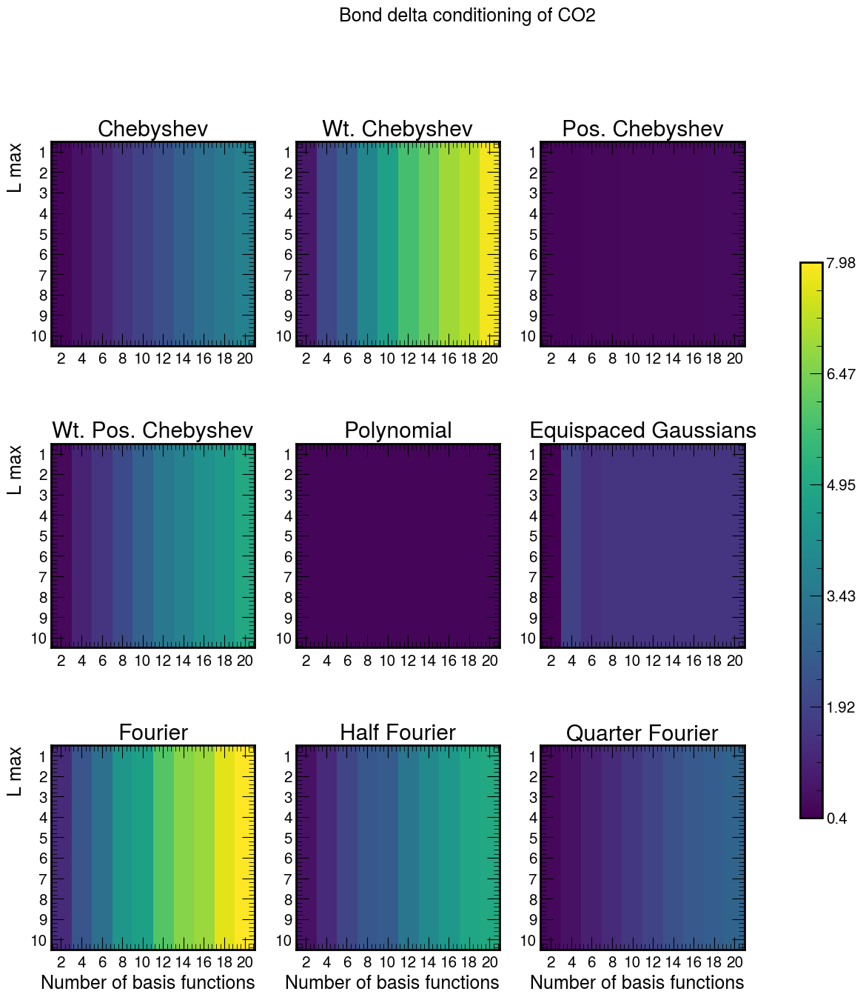

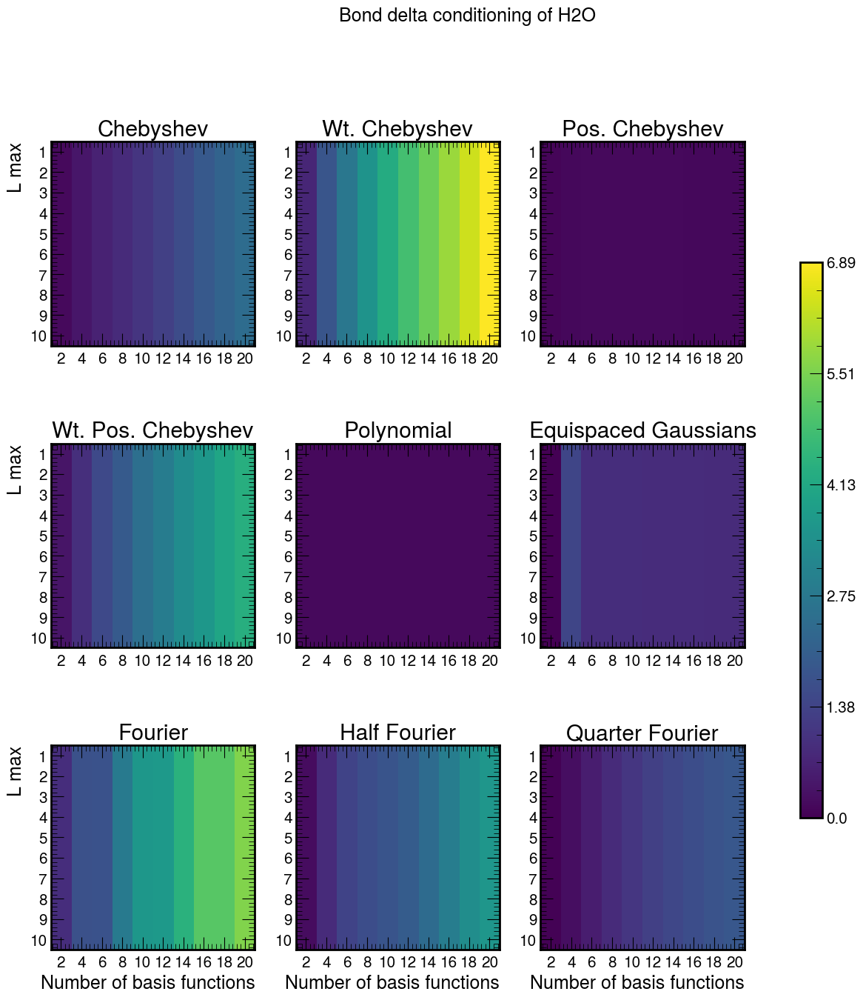

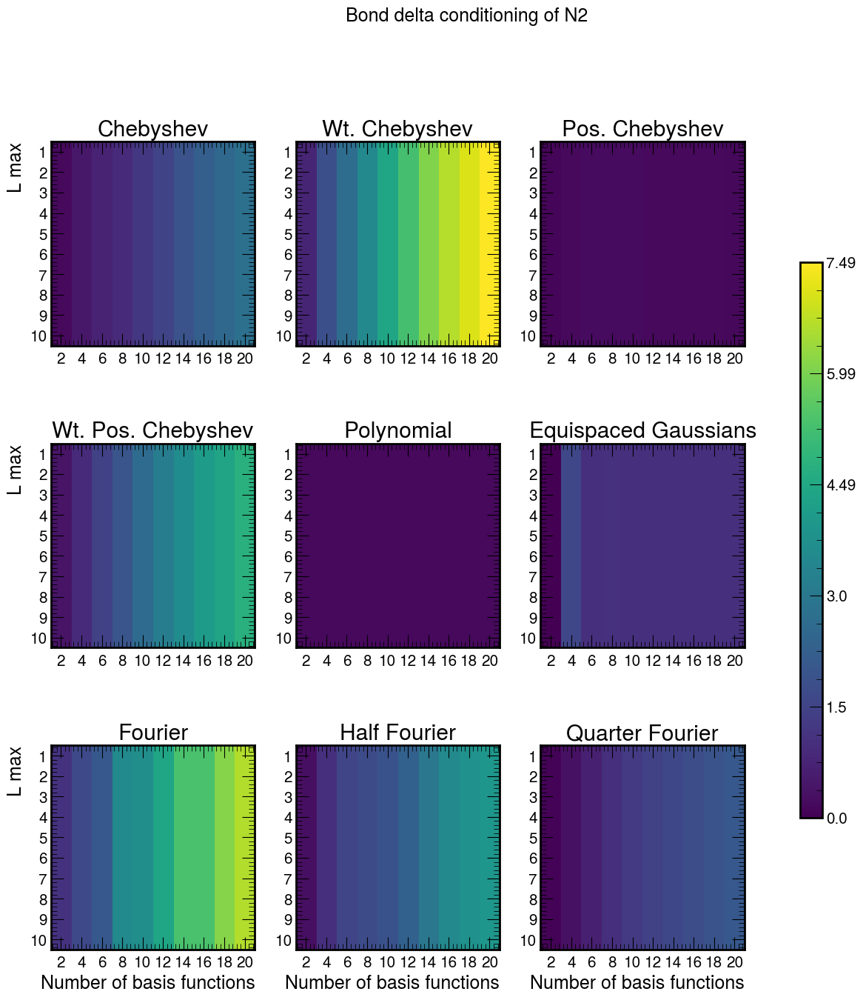

In [104]:
#Make heatmap from above cell

for mol in ["CO2","H2O","N2"]:
    print(conditioning[mol][0][0][0])
    condition_matrix = np.zeros((len(L_max_array),len(N_max_array),len(bases)))
    
    for j,L_max in enumerate(L_max_array):
        for k,N_max in enumerate(N_max_array):
            for i,basis in enumerate(bases):
                condition_matrix[j][k][i] = np.mean(conditioning[mol][j][k][i])
                #print("here")
    #print(condition_matrix[0][0][0],conditioning[mol][0][0][0])
    #print(condition_matrix[0][0][1],conditioning[mol][0][0][1])
    condition_matrix_reorder = np.transpose(condition_matrix,(2,0,1))
    #print(condition_matrix_reorder.shape,condition_matrix.shape)
    #print("here",condition_matrix[:][:][0],print(condition_matrix[:][:][1]))
    title = "Bond delta conditioning of "+mol
    savename = "AvgCond_BD_v2_"+mol
    #condition_matrix,N_max_array,L_max_array,global_title,subtitles,savename,savepath,variances = 0
    sensitivity_heatmap(condition_matrix_reorder,N_max_array,L_max_array,title,bases_titles,savename,"./Figures_v2/")

[0.5154867469566377, 0.5171294970960869, 0.5186904839468622, 0.5201673426100638, 0.5215577565907531, 0.5228594333975518, 0.5240700762108755, 0.5251873520136077, 0.5262088566939245, 0.5271320777366533, 0.5275560075133707, 0.5277981088497647, 0.5279389169756176, 0.5279697519385719, 0.5281064506682437, 0.5283267587537672, 0.5286728418437847, 0.5292844629875549, 0.5297858773641776, 0.5301734393797787, 0.5304431638025136, 0.5305906934677784, 0.5306112705395468, 0.5304997116671024, 0.5302503871479829, 0.5298572039425287]
[0.1616322343852043, 0.1618044963147057, 0.1619779158742944, 0.1621523419507263, 0.1623276246148729, 0.16250359963386518, 0.1626801026956421, 0.16285696498754065, 0.16303400401341356, 0.16321104926278335, 0.16329949449495282, 0.16335257196062902, 0.16338436604993017, 0.16339159196186773, 0.16342320300851312, 0.16347618527576302, 0.1635643606973932, 0.16374025944676268, 0.16391537943504492, 0.16408951715455092, 0.16426247108147754, 0.1644340263693575, 0.16460397465630622, 0.1

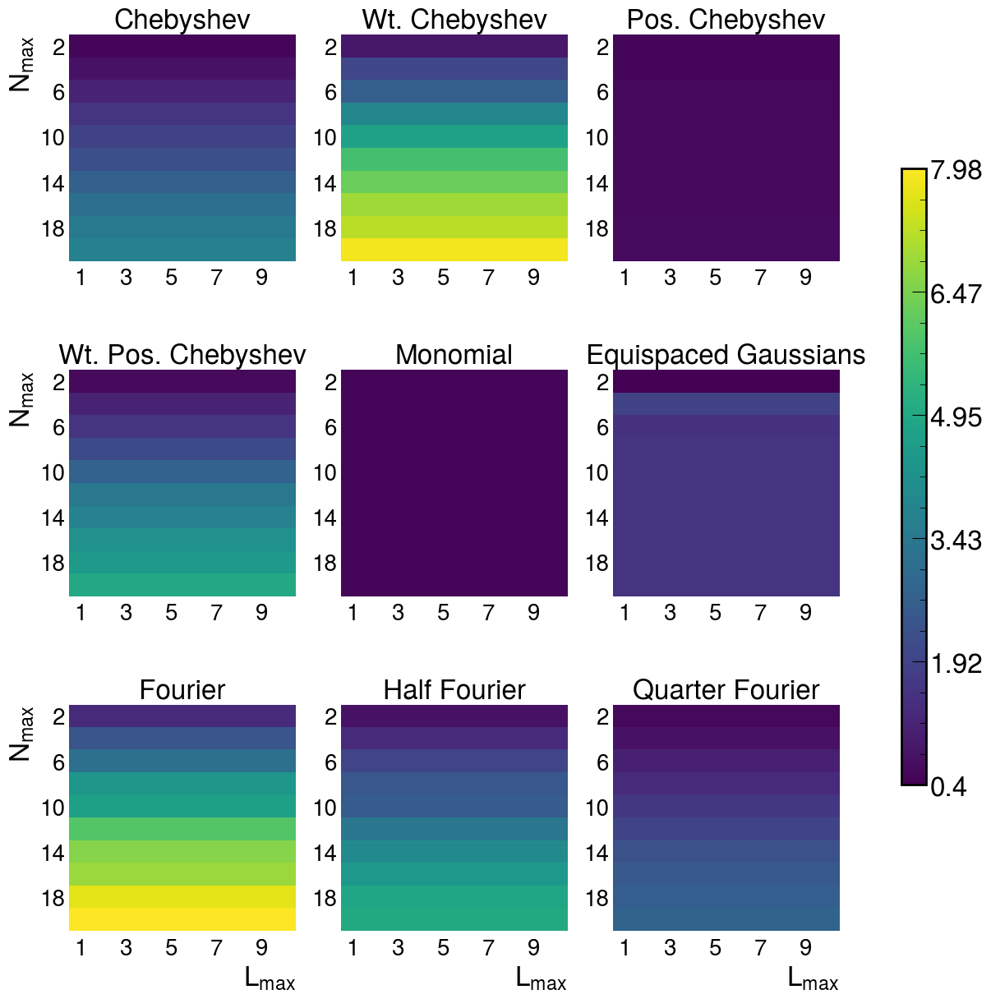

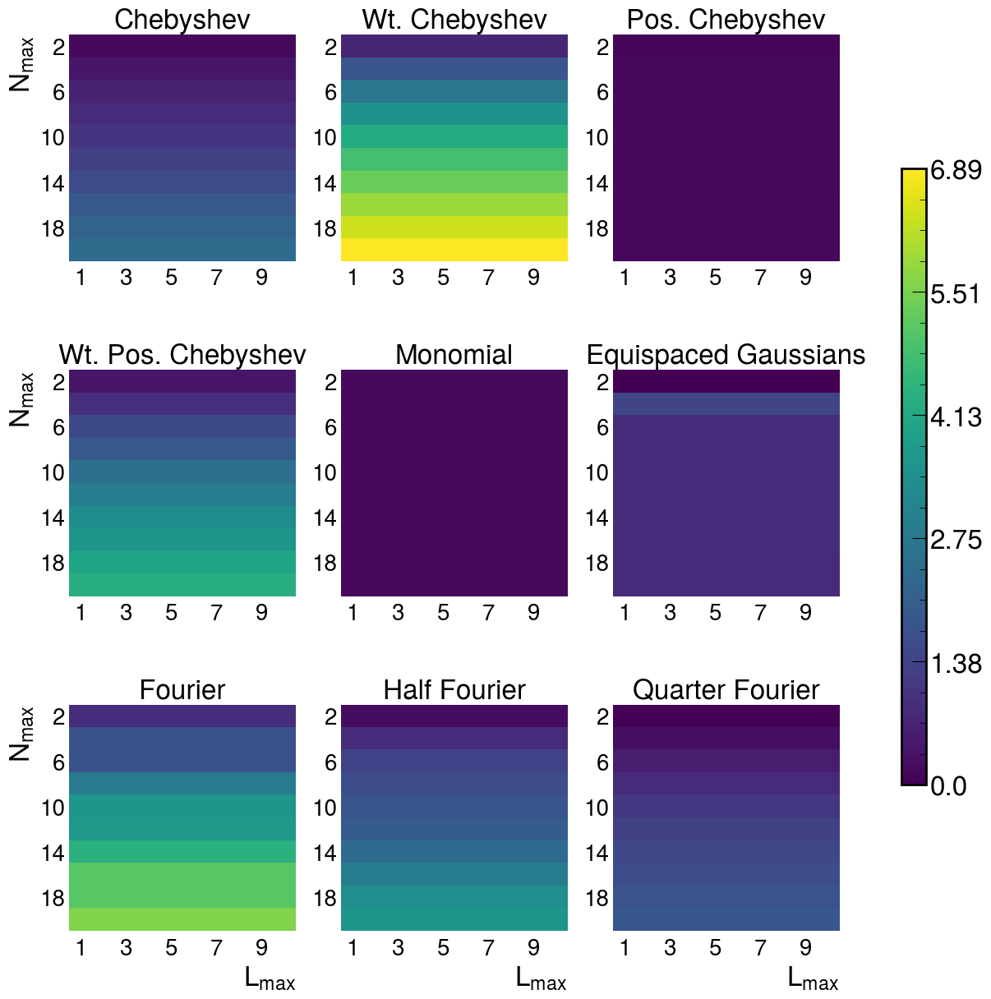

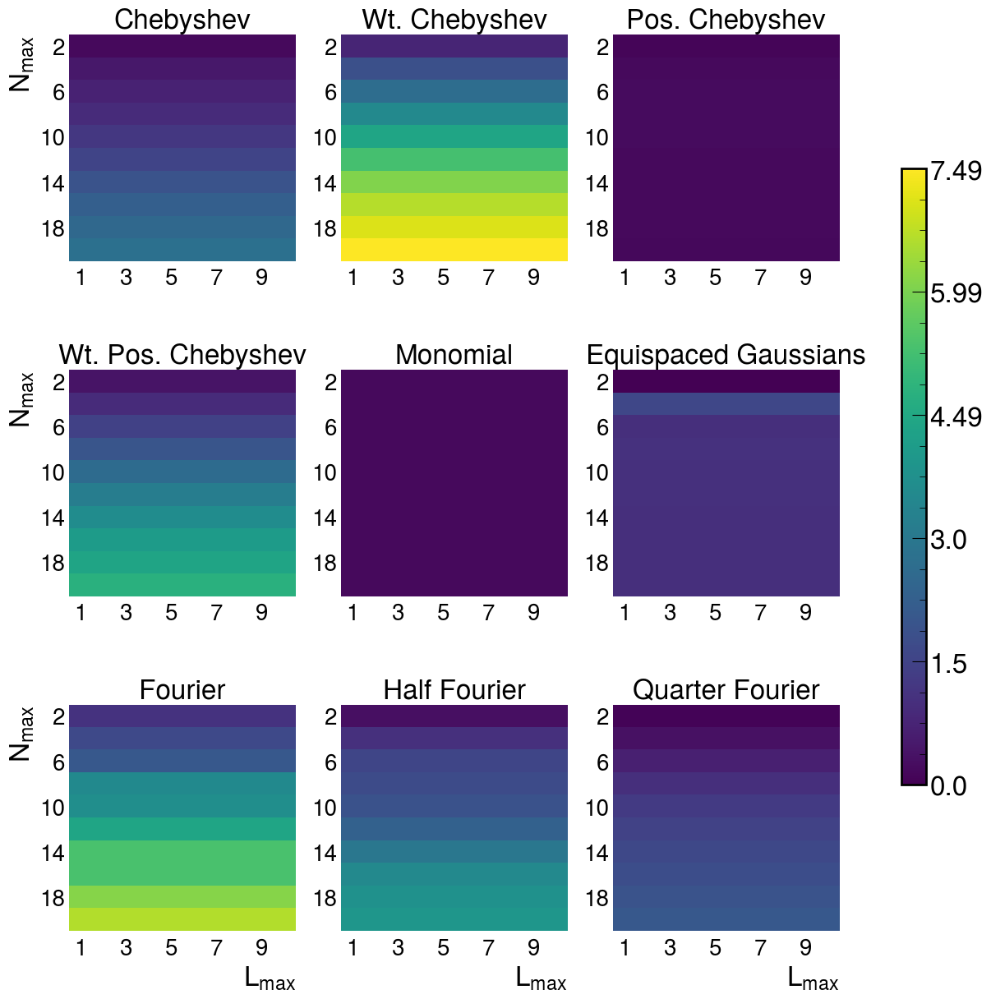

In [259]:
#Make heatmap from above cell

for mol in ["CO2","H2O","N2"]:
    print(conditioning[mol][0][0][0])
    condition_matrix = np.zeros((len(L_max_array),len(N_max_array),len(bases)))
    
    for j,L_max in enumerate(L_max_array):
        for k,N_max in enumerate(N_max_array):
            for i,basis in enumerate(bases):
                condition_matrix[j][k][i] = np.mean(conditioning[mol][j][k][i])
                #print("here")
    #print(condition_matrix[0][0][0],conditioning[mol][0][0][0])
    #print(condition_matrix[0][0][1],conditioning[mol][0][0][1])
    condition_matrix_reorder = np.transpose(condition_matrix,(2,0,1))
    #print(condition_matrix_reorder.shape,condition_matrix.shape)
    #print("here",condition_matrix[:][:][0],print(condition_matrix[:][:][1]))
    title = "Bond delta conditioning of "+mol
    savename = "AvgCond_BD_v3_"+mol
    #condition_matrix,N_max_array,L_max_array,global_title,subtitles,savename,savepath,variances = 0
    sensitivity_heatmap_v3(condition_matrix_reorder,N_max_array,L_max_array,title,bases_titles,savename,"./Figures_v3/")

In [301]:
cutoff = cutoff_array[0]
plot = True
for mol in ["N2","CO2","H2O"]:
    default_xyz = ase.io.read(xyz_directory+"default_"+mol+".extxyz")
    conditioning[mol] = []#np.zeros((len(bases),len(L_max_array),len(N_max_array)))
    for j,L_max in enumerate(L_max_array):
        conditioning[mol].append([])
        for k,N_max in enumerate(N_max_array):
            conditioning[mol][j].append([])
            for i,basis in enumerate(bases):
                conditioning[mol][j][k].append([])
                filename = ace_directory + "norm_default_"+mol+"_"+basis+"_0_"+str(cutoff)+"_Nmax_"+str(N_max)+"_Lmax_"+str(L_max)+"_cutoff_"+str(cutoff)+".npz"
                default = np.load(filename)["ACE"][0]
                for nudge in nudge_array:
                    #direction = "+"
                    #if nudge < 0:
                    #    direction = "-"
                    #print(nudge,direction)
                    filename = ace_directory+"norm_alignment_angle_"+str(nudge*1000.0).split(".")[0]+"_"+mol+"_"+basis+"_0_"+str(cutoff)+"_Nmax_"+str(N_max)+"_Lmax_"+str(L_max)+"_cutoff_"+str(cutoff)+".npz"
                    comparison = np.load(filename)["ACE"][0]
                    #print("desc",default,comparison,comparison.shape)
                    comparison_xyz = ase.io.read(xyz_directory+"alignment_angle_"+str(nudge*1000.0).split(".")[0]+"_"+mol+".extxyz")
                    conditioning[mol][j][k][i].append(condition_number(default,comparison,default_xyz.positions,comparison_xyz.positions))
                #print("coord",mol,basis,default_xyz.positions,comparison_xyz.positions)
    #print("Mol",mol,"basis",basis,"L_max",L_max,"N_max",N_max,":\n")
    print(conditioning[mol][j][k][i])
    #conditioning_matrix,delta_array,global_title,subtitles,savename,savepath
    if plot:
        for j,L_max in enumerate(L_max_array):
            for k,N_max in enumerate(N_max_array):
                plt.ioff()
                condition_dependence_matrix_v3(conditioning[mol][j][k][:],squish_array,"Angular conditioning: "+mol+" L_max:"+str(L_max) +", N_max:"+str(N_max),bases_titles,"Angle_v3_"+mol+"_"+str(L_max) +"_"+str(N_max)+"_"+str(cutoff),"./Figures_v3/",color = color_dict[mol])
                plt.ion()

[1.4981743065838692e-08, 1.069137315763846e-08, 1.6396070650613126e-08, 4.309246026123741e-08, 2.8459526590836112e-08, 3.371621137484875e-08, 4.101195415323819e-08, 1.22976120351546e-07, 7.405093393829163e-08, 2.5624996507573443e-06, 4.1659054375081735e-06, 1.9732280021861513e-05, 3.574842142245689e-05, 3.5748421416396005e-05, 1.9732280017204502e-05, 4.165905436923911e-06, 2.5624996479502178e-06, 7.405093388291963e-08, 1.2297612048278764e-07, 4.101195026940901e-08, 3.371620937804154e-08, 2.8459533522062624e-08, 4.3092460290782884e-08, 1.639606957346595e-08, 1.0691373604611065e-08, 1.4981739813754784e-08]


[0.10209905173576843, 0.06581644372655532, 0.03224374733412478, 0.02681381350692519, 0.021414460213095513, 0.016039523704637845, 0.010682870949582158, 0.005338403674651016, 0.002135029022406791, 0.0002135069546476012, 0.0001064197695266058, 5.3209879632564276e-05, 2.3134559787405184e-05, 2.3134559787405184e-05, 5.3209879632564276e-05, 0.0001064197695266058, 0.00021350695464882326, 0.002135029022406791, 0.005338403674652556, 0.010682870949578961, 0.01603952370464164, 0.021414460213094438, 0.026813813506925206, 0.03224374733412296, 0.06581644372655551, 0.1020990517357685]
(9, 10, 10) (10, 10, 9)
[0.9179410376857239, 0.9049008562044916, 0.825702872598481, 0.8084817226627363, 0.7906508000082101, 0.7723968280407505, 0.7538905598284733, 0.7352846019060415, 0.72412950110333, 0.7174531467774975, 0.7170827432215549, 0.7168975682584487, 0.7167864636464668, 0.716638340473884, 0.7165272514875703, 0.7163421186793134, 0.7159718987913882, 0.7093191875015326, 0.6982881565903422, 0.6801075093256023, 0.

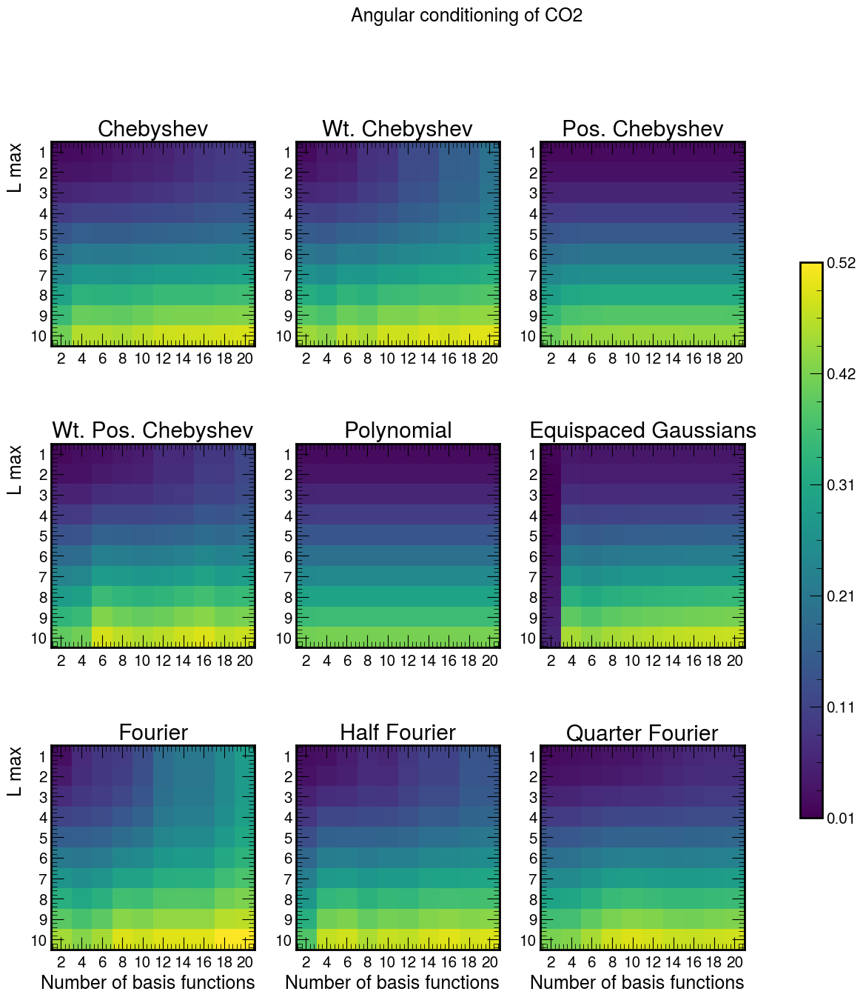

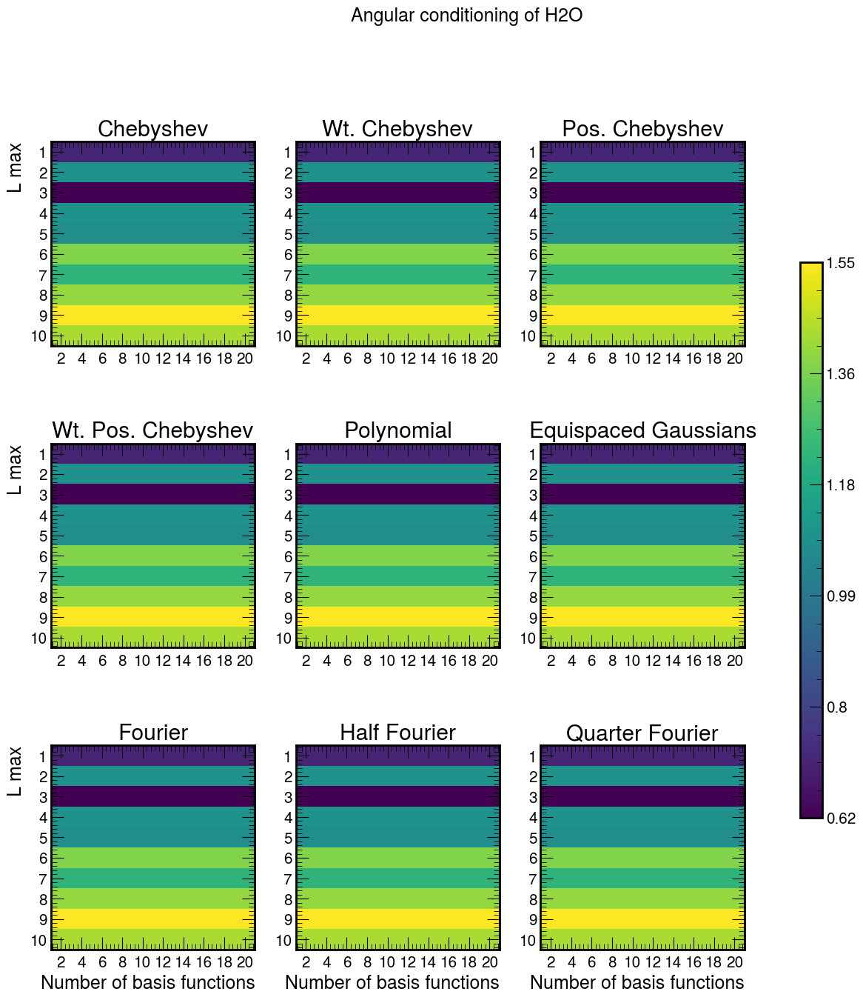

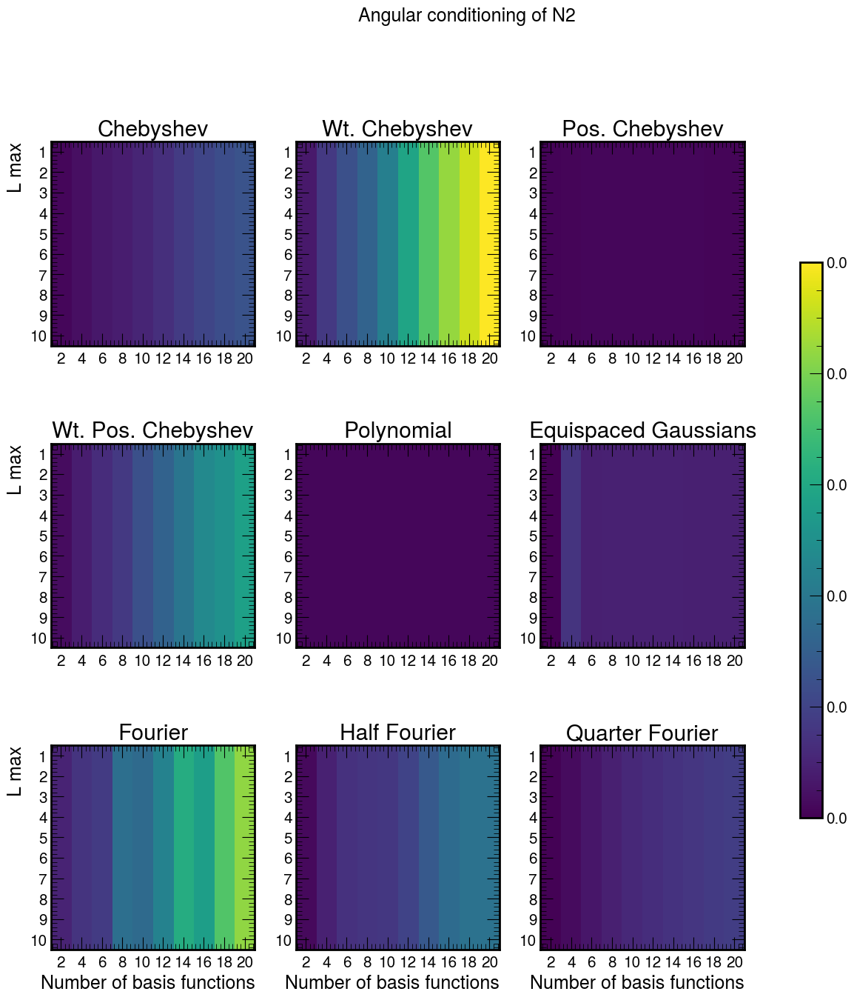

In [107]:
#Make heatmap from above cell

for mol in ["CO2","H2O","N2"]:
    print(conditioning[mol][0][0][0])
    condition_matrix = np.zeros((len(L_max_array),len(N_max_array),len(bases)))
    
    for j,L_max in enumerate(L_max_array):
        for k,N_max in enumerate(N_max_array):
            for i,basis in enumerate(bases):
                condition_matrix[j][k][i] = np.mean(conditioning[mol][j][k][i])
                #print("here")
    
    condition_matrix_reorder = np.transpose(condition_matrix,(2,0,1))
    print(condition_matrix_reorder.shape,condition_matrix.shape)
    
    title = "Angular conditioning of "+mol
    savename = "AvgCond_AA_v2_"+mol
    sensitivity_heatmap(condition_matrix_reorder,N_max_array,L_max_array,title,bases_titles,savename,"./Figures_v2/")

[0.10209905173576843, 0.06581644372655532, 0.03224374733412478, 0.02681381350692519, 0.021414460213095513, 0.016039523704637845, 0.010682870949582158, 0.005338403674651016, 0.002135029022406791, 0.0002135069546476012, 0.0001064197695266058, 5.3209879632564276e-05, 2.3134559787405184e-05, 2.3134559787405184e-05, 5.3209879632564276e-05, 0.0001064197695266058, 0.00021350695464882326, 0.002135029022406791, 0.005338403674652556, 0.010682870949578961, 0.01603952370464164, 0.021414460213094438, 0.026813813506925206, 0.03224374733412296, 0.06581644372655551, 0.1020990517357685]
(9, 10, 10) (10, 10, 9)
[0.9179410376857239, 0.9049008562044916, 0.825702872598481, 0.8084817226627363, 0.7906508000082101, 0.7723968280407505, 0.7538905598284733, 0.7352846019060415, 0.72412950110333, 0.7174531467774975, 0.7170827432215549, 0.7168975682584487, 0.7167864636464668, 0.716638340473884, 0.7165272514875703, 0.7163421186793134, 0.7159718987913882, 0.7093191875015326, 0.6982881565903422, 0.6801075093256023, 0.

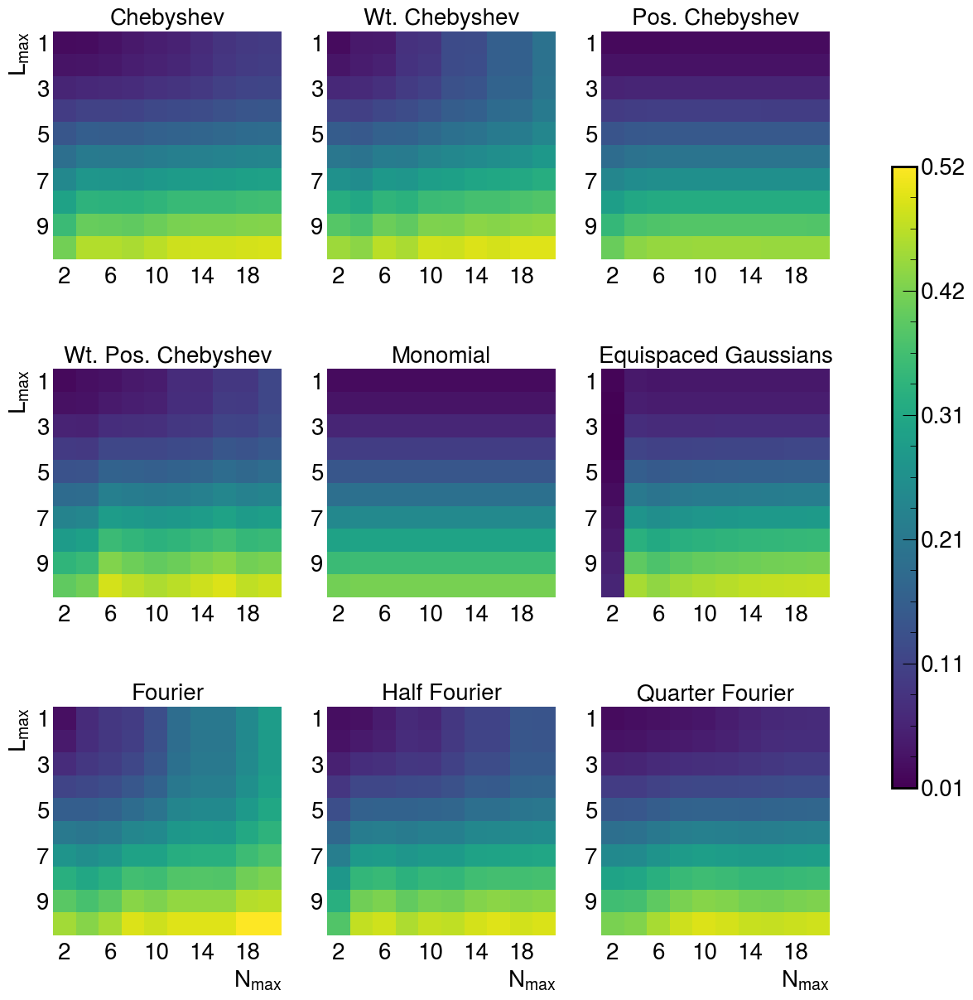

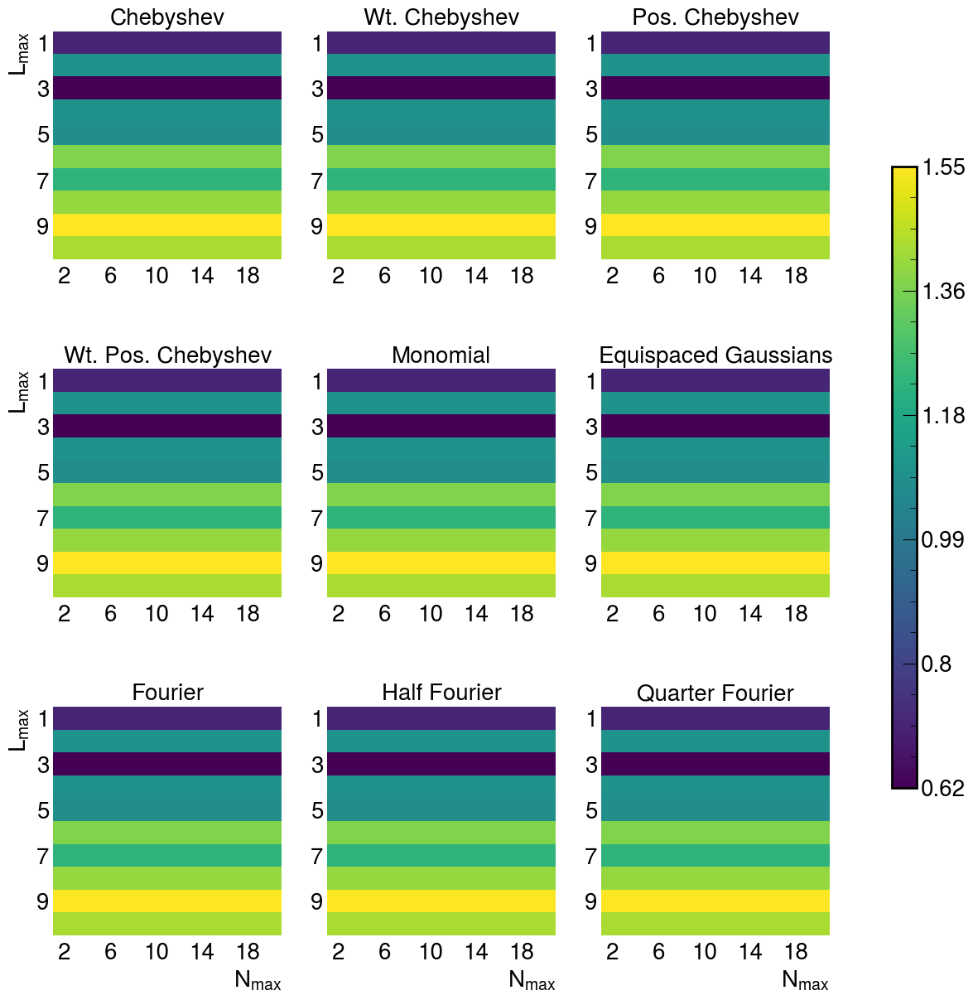

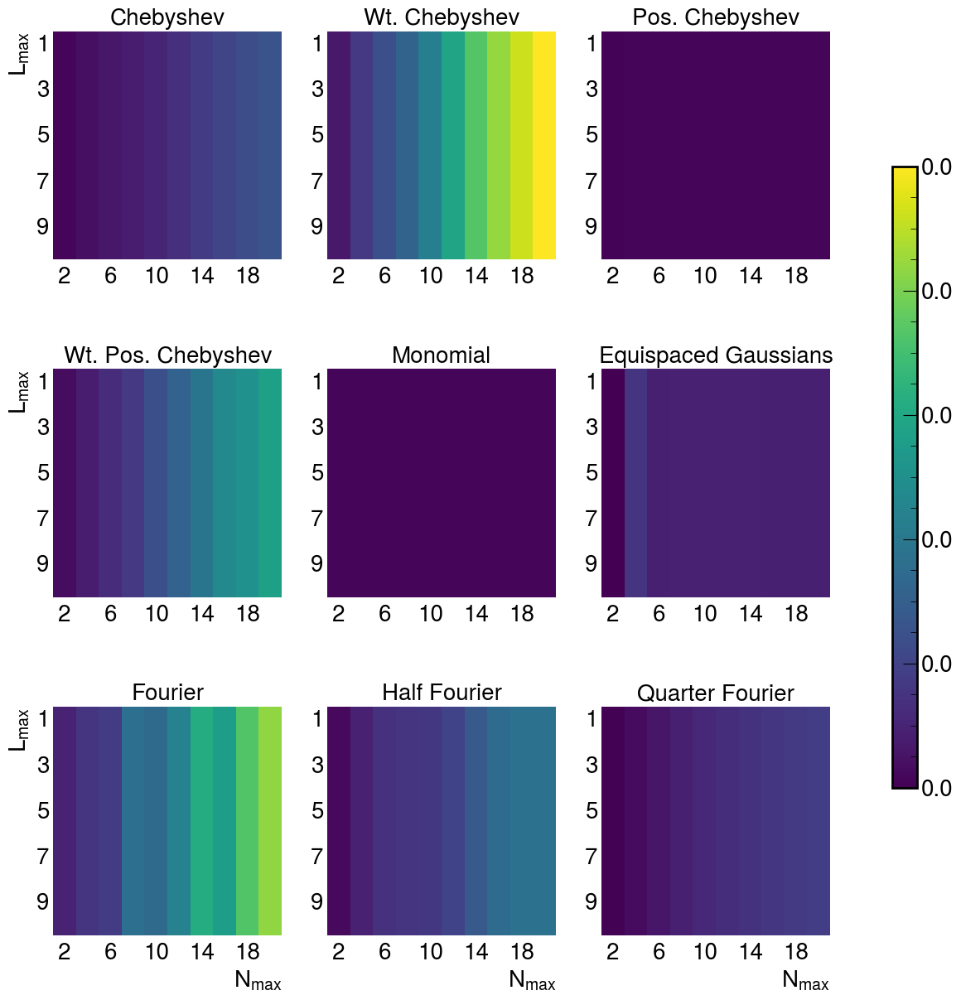

In [254]:
#Make heatmap from above cell

for mol in ["CO2","H2O","N2"]:
    print(conditioning[mol][0][0][0])
    condition_matrix = np.zeros((len(L_max_array),len(N_max_array),len(bases)))
    
    for j,L_max in enumerate(L_max_array):
        for k,N_max in enumerate(N_max_array):
            for i,basis in enumerate(bases):
                condition_matrix[j][k][i] = np.mean(conditioning[mol][j][k][i])
                #print("here")
    
    condition_matrix_reorder = np.transpose(condition_matrix,(2,0,1))
    print(condition_matrix_reorder.shape,condition_matrix.shape)
    
    title = "Angular conditioning of "+mol
    savename = "AvgCond_AA_v3_"+mol
    sensitivity_heatmap_v3(condition_matrix_reorder,N_max_array,L_max_array,title,bases_titles,savename,"./Figures_v3/")

[-0.5, -0.45, -0.4, -0.35, -0.3, -0.25, -0.2, -0.15, -0.1, -0.05, -0.025, -0.01, -0.001, 0.001, 0.01, 0.025, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45, 0.5]


/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[1][i][j] = cosine_similarity([descriptor_matrix["H2O"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated,

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[3][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated,

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[1][i][j] = cosine_similarity([descriptor_matrix["H2O"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated,

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[1][i][j] = cosine_similarity([descriptor_matrix["H2O"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before per

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[1][i][j] = cosine_similarity([descriptor_matrix["H2O"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated,

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[1][i][j] = cosine_similarity([descriptor_matrix["H2O"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated,

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[3][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before per

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[3][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated,

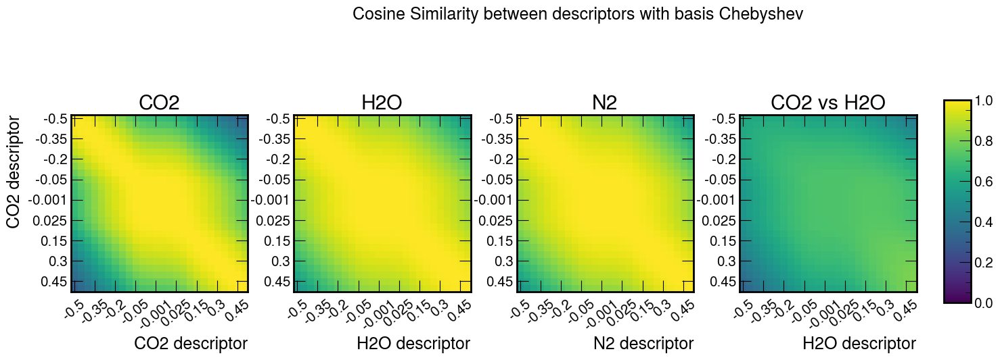

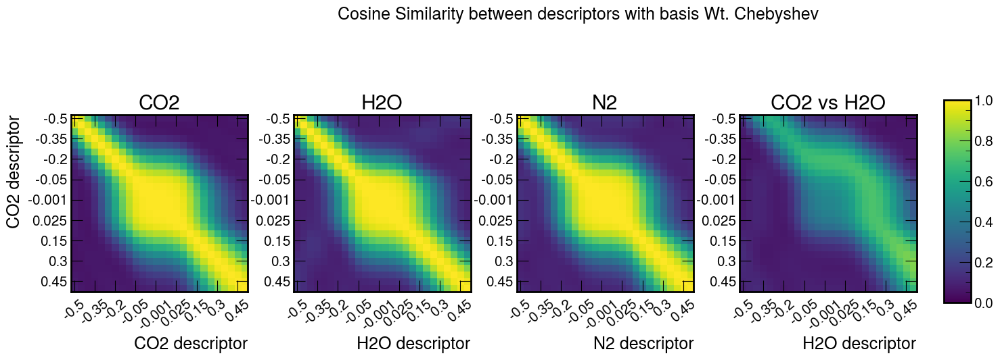

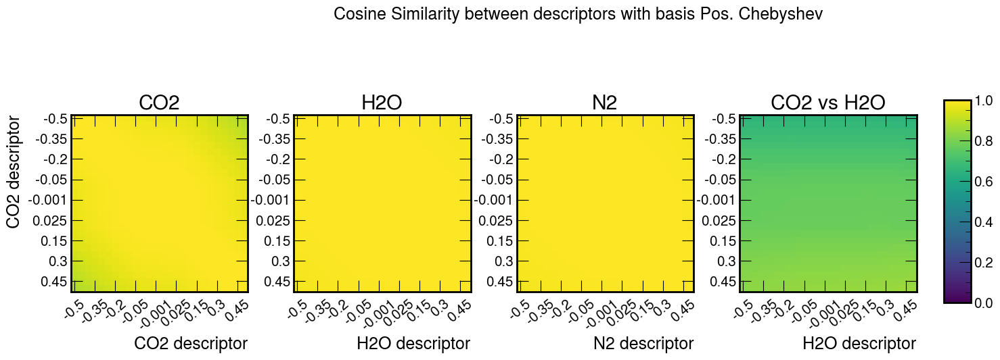

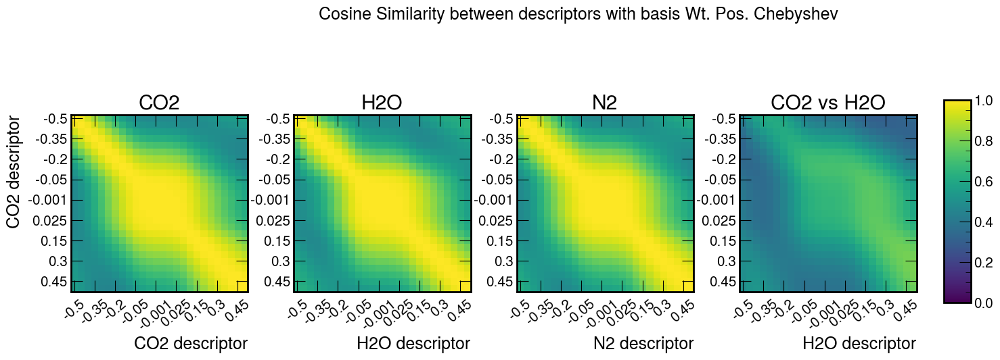

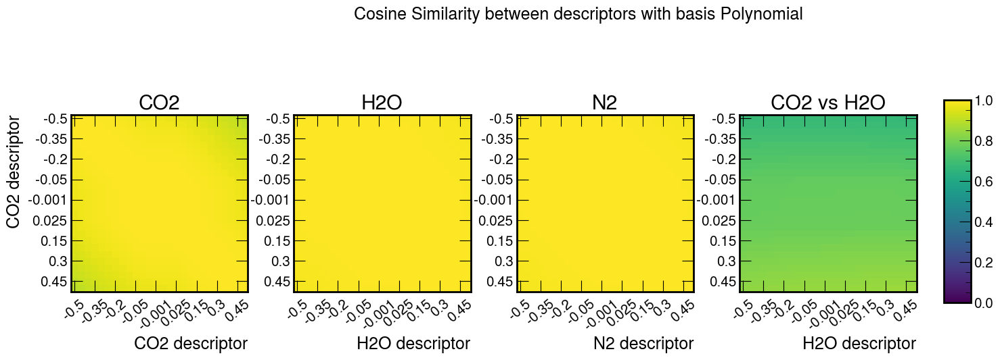

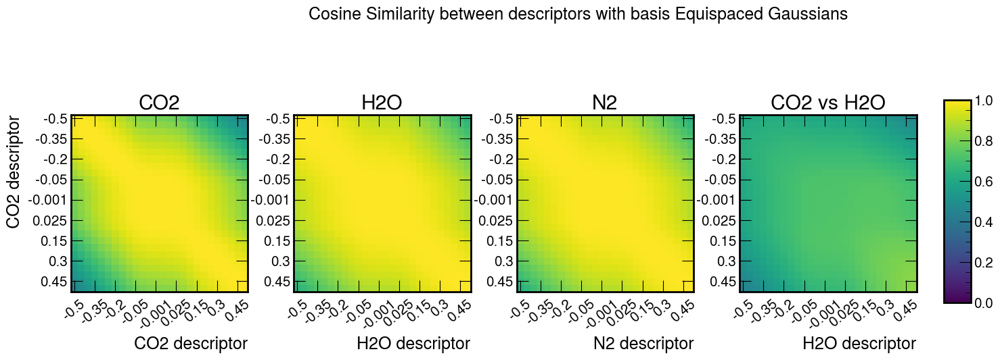

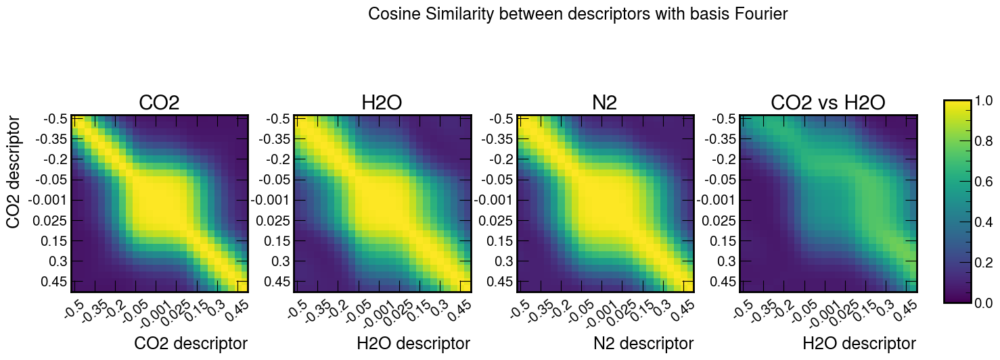

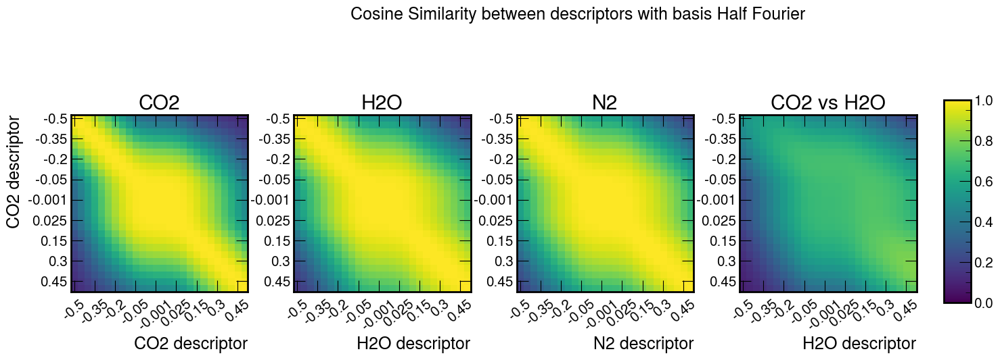

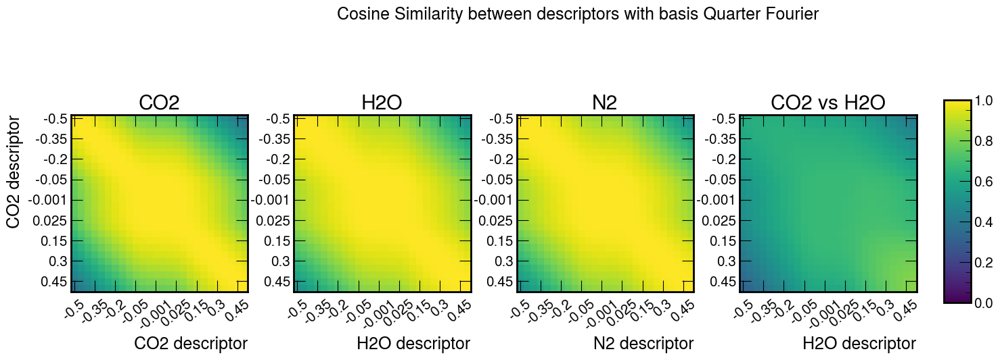

In [149]:
#Make the cosine similarity plot
print(squish_array)
for i,basis in enumerate(bases):
    descriptors = {"N2":{},"CO2":{},"H2O":{}}
    cutoff = cutoff_array[0]
    for mol in ["CO2","H2O","N2"]:
    
        descriptors[mol] = []
        for j,L_max in enumerate([3]):
            for k,N_max in enumerate([10]):

                for squish in squish_array:
                    filename = ace_directory+"norm_bond_delta_"+str(squish*1000.0).split(".")[0]+"_"+mol+"_"+basis+"_0_"+str(cutoff)+"_Nmax_"+str(N_max)+"_Lmax_"+str(L_max)+"_cutoff_"+str(cutoff)+".npz"
                    descriptors[mol].append(np.load(filename)["ACE"][0])
                    
    #print(condition_matrix)
    title = "Cosine Similarity between descriptors with basis "+bases_titles[i]
    savename = ("CosineSimilarity_BondDelta_%s_L_%s_N_%s" %(basis,str(L_max),str(N_max)))
    cosine_similarity_heatmap(descriptors,squish_array,["N2"],title,savename,"./Figures_v2/")

[-0.5, -0.45, -0.4, -0.35, -0.3, -0.25, -0.2, -0.15, -0.1, -0.05, -0.025, -0.01, -0.001, 0.001, 0.01, 0.025, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45, 0.5]


/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][0][i][j] = cosine_similarity([descriptor_matrix[basis]["CO2"][i]],Y = [descriptor_matrix[basis]["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][1][i][j] = cosine_similarity([descriptor_matrix[basis]["H2O"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:21: DeprecationWarning: Conversion of an array 

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][1][i][j] = cosine_similarity([descriptor_matrix[basis]["H2O"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][2][i][j] = cosine_similarity([descriptor_matrix[basis]["CO2"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:19: DeprecationWarning: Conversion of an array 

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][2][i][j] = cosine_similarity([descriptor_matrix[basis]["CO2"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][0][i][j] = cosine_similarity([descriptor_matrix[basis]["CO2"][i]],Y = [descriptor_matrix[basis]["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:20: DeprecationWarning: Conversion of an array 

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][0][i][j] = cosine_similarity([descriptor_matrix[basis]["CO2"][i]],Y = [descriptor_matrix[basis]["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][1][i][j] = cosine_similarity([descriptor_matrix[basis]["H2O"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:21: DeprecationWarning: Conversion of an array 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][1][i][j] = cosine_similarity([descriptor_matrix[basis]["H2O"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from y

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][0][i][j] = cosine_similarity([descriptor_matrix[basis]["CO2"][i]],Y = [descriptor_matrix[basis]["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][1][i][j] = cosine_similarity([descriptor_matrix[basis]["H2O"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:21: DeprecationWarning: Conversion of an array 

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][0][i][j] = cosine_similarity([descriptor_matrix[basis]["CO2"][i]],Y = [descriptor_matrix[basis]["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][1][i][j] = cosine_similarity([descriptor_matrix[basis]["H2O"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:21: DeprecationWarning: Conversion of an array 

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][1][i][j] = cosine_similarity([descriptor_matrix[basis]["H2O"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][2][i][j] = cosine_similarity([descriptor_matrix[basis]["CO2"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:19: DeprecationWarning: Conversion of an array 

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][1][i][j] = cosine_similarity([descriptor_matrix[basis]["H2O"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][2][i][j] = cosine_similarity([descriptor_matrix[basis]["CO2"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:19: DeprecationWarning: Conversion of an array 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[axis][2][i][j] = cosine_similarity([descriptor_matrix[basis]["CO2"][i]],Y = [descriptor_matrix[basis]["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/1523846388.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from y

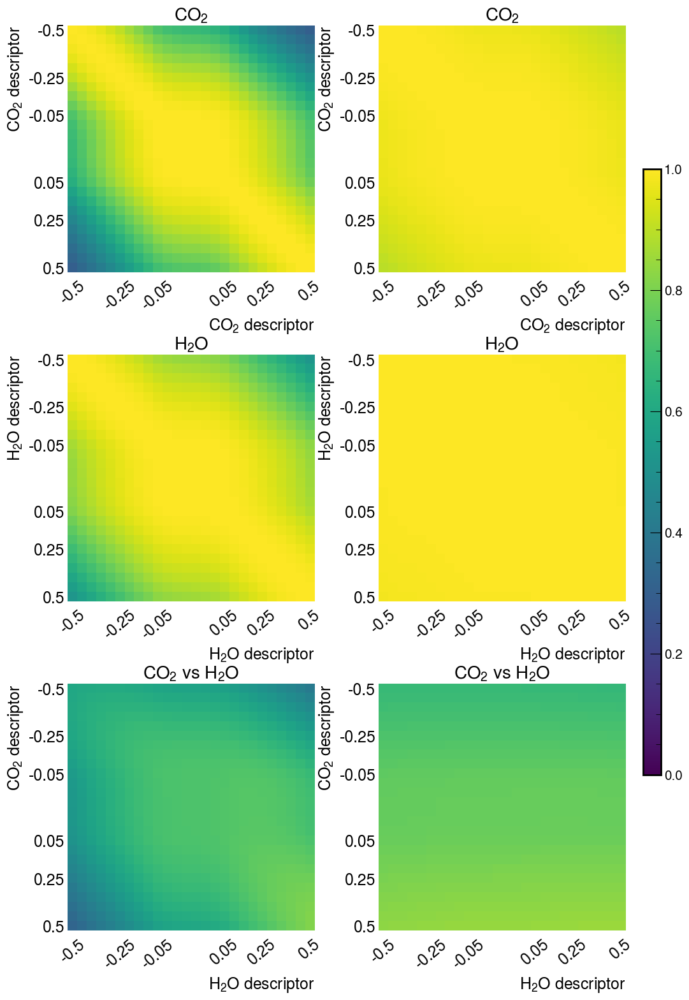

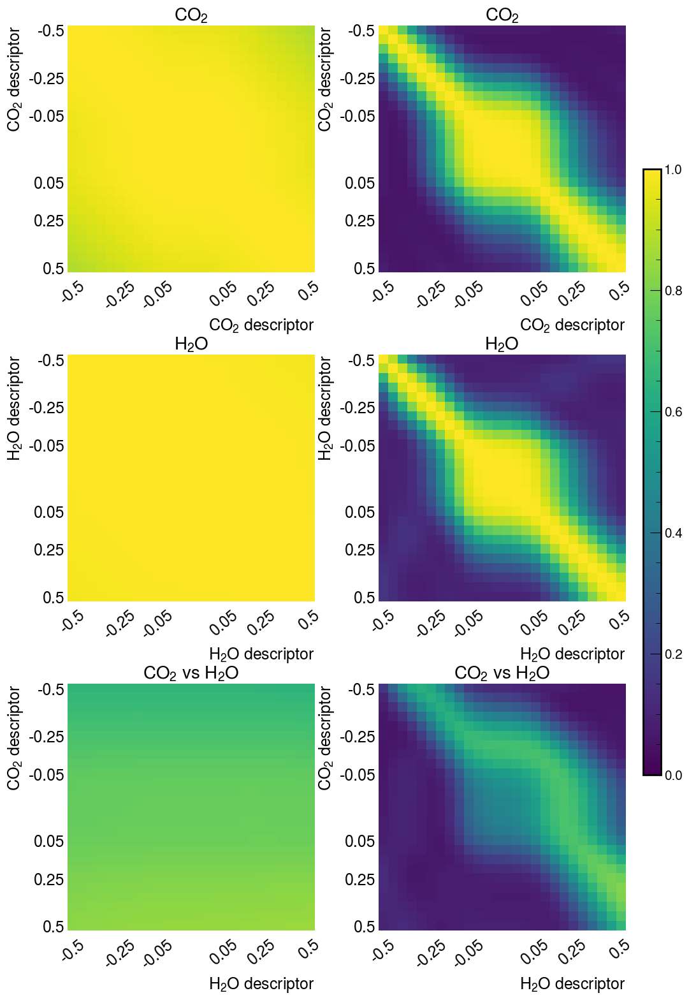

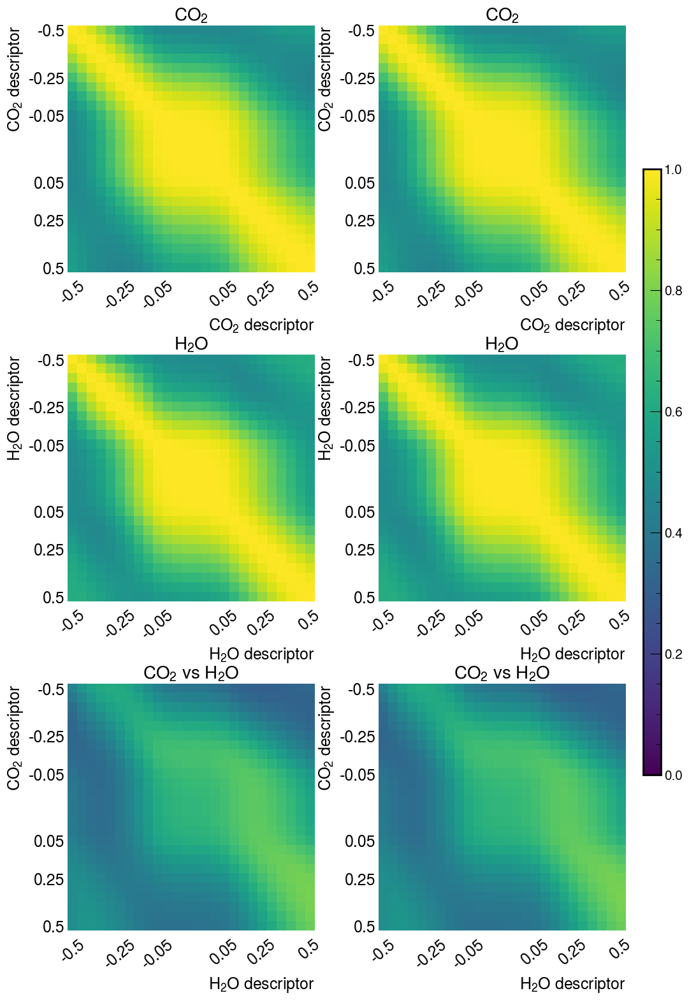

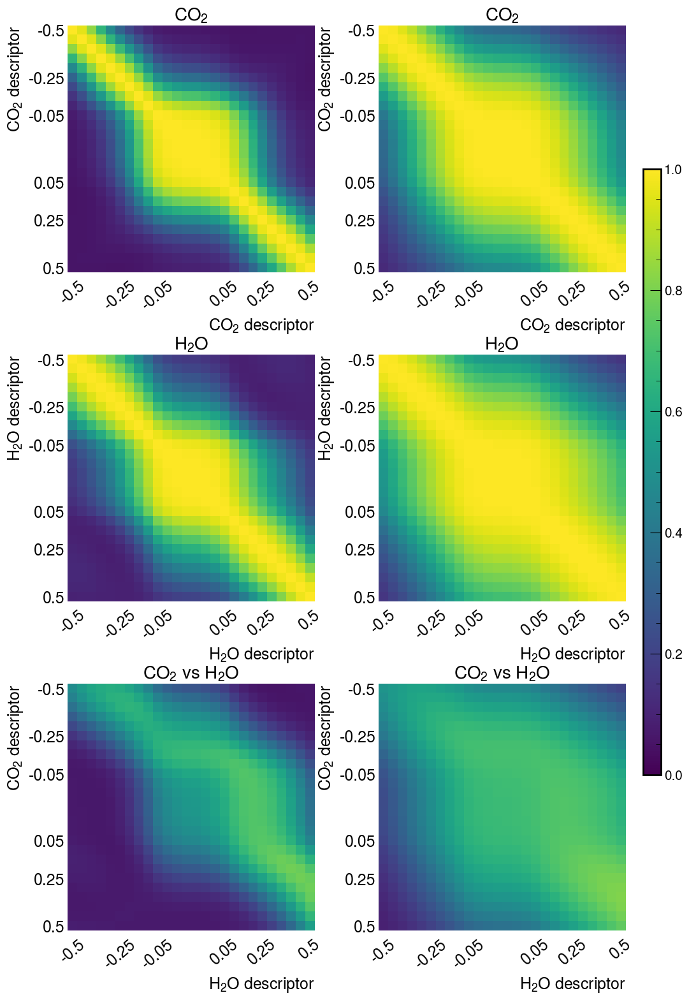

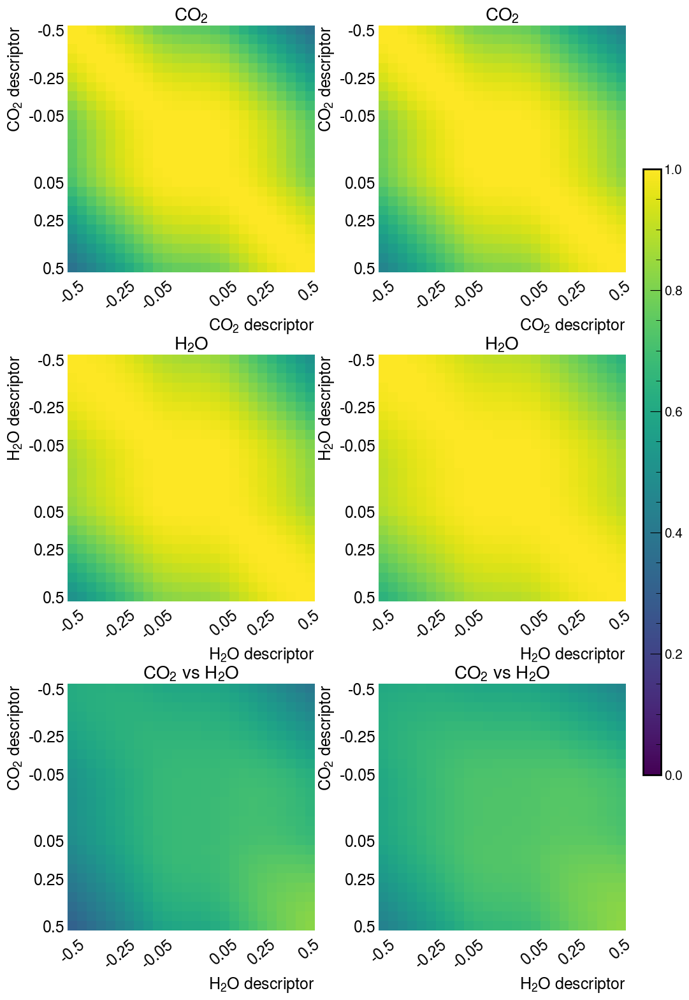

In [308]:
#Make the cosine similarity plot
print(squish_array)
descriptors = {}
for i,basis in enumerate(bases):
    descriptors[basis] = {}
    cutoff = cutoff_array[0]
    for mol in ["CO2","H2O"]:
    
        descriptors[basis][mol] = []
        for j,L_max in enumerate([3]):
            for k,N_max in enumerate([10]):

                for squish in squish_array:
                    filename = ace_directory+"norm_bond_delta_"+str(squish*1000.0).split(".")[0]+"_"+mol+"_"+basis+"_0_"+str(cutoff)+"_Nmax_"+str(N_max)+"_Lmax_"+str(L_max)+"_cutoff_"+str(cutoff)+".npz"
                    descriptors[basis][mol].append(np.load(filename)["ACE"][0])
                    
    #print(condition_matrix)
for small_bases in [["chebyshev","poly"],["positive_chebyshev","weighted_chebyshev"],["weighted_positive_chebyshev","weighted_positive_chebyshev"],["fourier","fourier_half"],["fourier_quarter","equispaced_gaussians"]]:
    title = "Cosine Similarity between descriptors with basis "+bases_titles[i]
    savename = ("CosineSimilarity_v3_BondDelta_L_%s_N_%s_%s_%s" %(str(L_max),str(N_max),small_bases[0],small_bases[1]))
    cosine_similarity_heatmap_v3(descriptors,small_bases,["Chebyshev","Monomial"],squish_array,["N2"],title,savename,"./Figures_v3/")

[-45.0, -30.0, -15.0, -12.5, -10.0, -7.5, -5, -2.5, -1.0, -0.1, -0.05, -0.025, -0.01, 0.01, 0.025, 0.05, 0.1, 1.0, 2.5, 5.0, 7.5, 10.0, 12.5, 15.0, 30.0, 45.0]


/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[1][i][j] = cosine_similarity([descriptor_matrix["H2O"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated,

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[3][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated,

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[1][i][j] = cosine_similarity([descriptor_matrix["H2O"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated,

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[1][i][j] = cosine_similarity([descriptor_matrix["H2O"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[2][i][j] = cosine_similarity([descriptor_matrix["N2"][i]],Y = [descriptor_matrix["N2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, a

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before per

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[3][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated,

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[1][i][j] = cosine_similarity([descriptor_matrix["H2O"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated,

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[1][i][j] = cosine_similarity([descriptor_matrix["H2O"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[2][i][j] = cosine_similarity([descriptor_matrix["N2"][i]],Y = [descriptor_matrix["N2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, a

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[0][i][j] = cosine_similarity([descriptor_matrix["CO2"][i]],Y = [descriptor_matrix["CO2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before per

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:19: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[1][i][j] = cosine_similarity([descriptor_matrix["H2O"][i]],Y = [descriptor_matrix["H2O"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  cosine_matrix[2][i][j] = cosine_similarity([descriptor_matrix["N2"][i]],Y = [descriptor_matrix["N2"][j]])[0]
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/3694620185.py:21: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, a

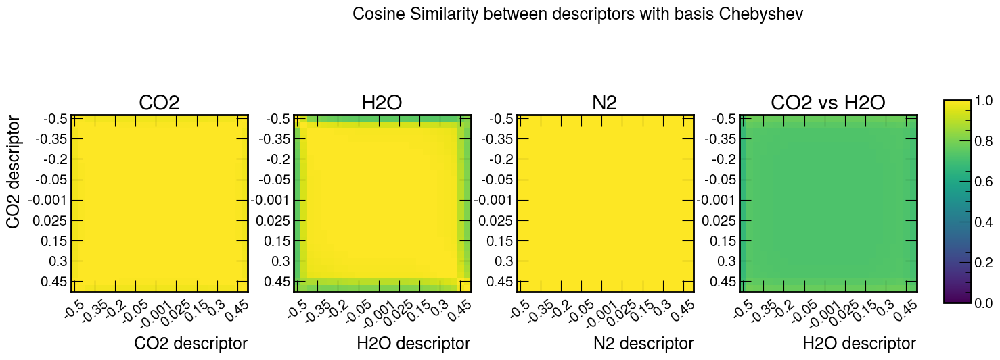

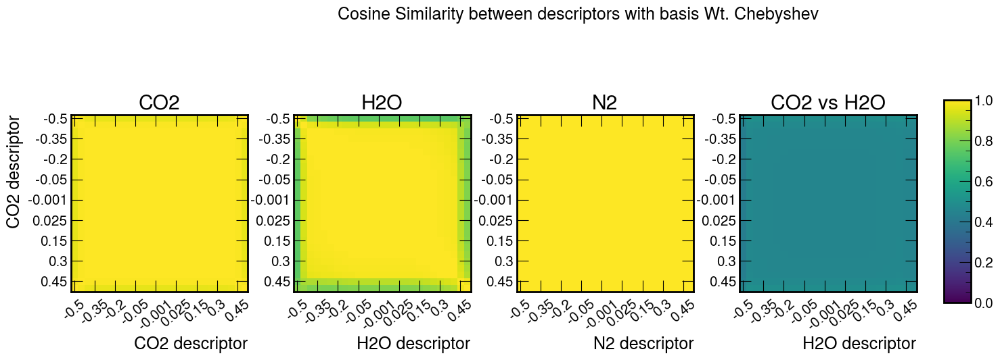

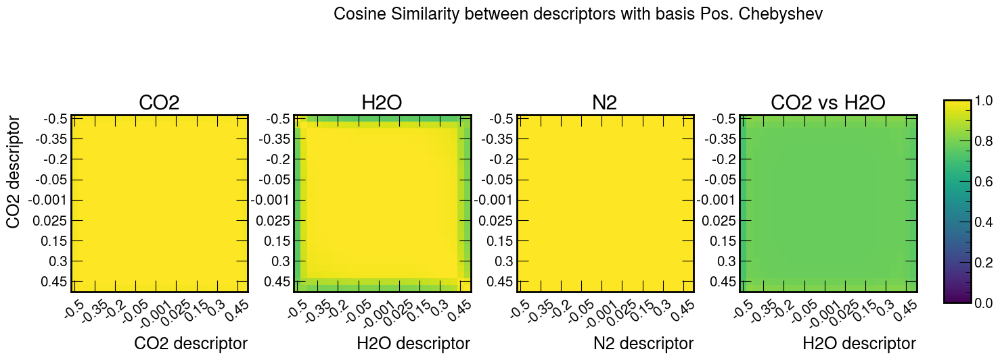

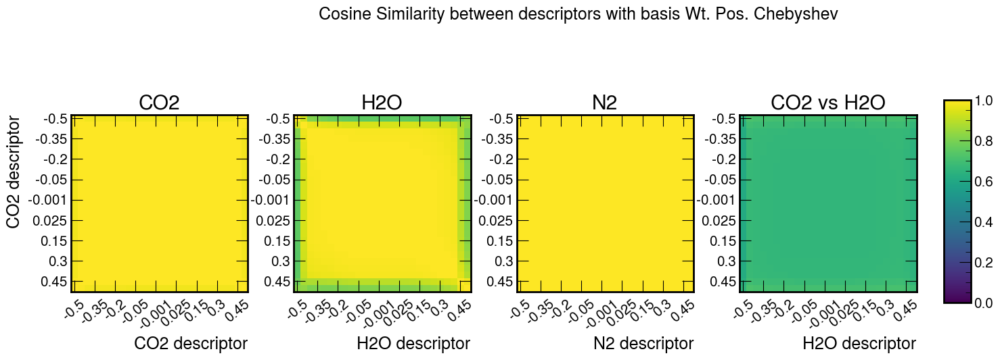

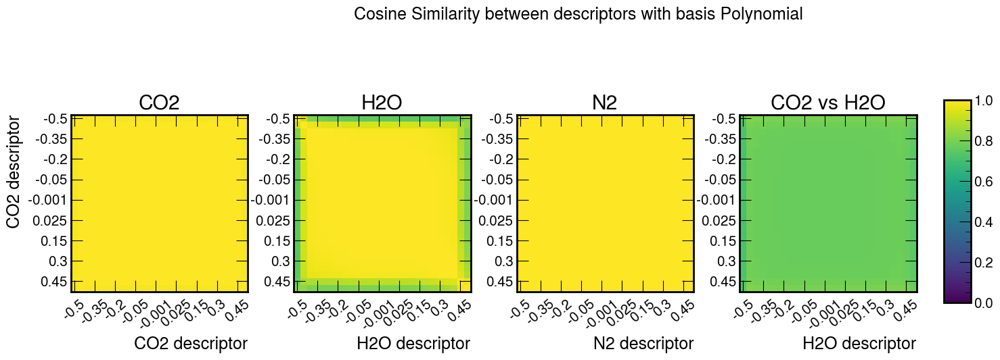

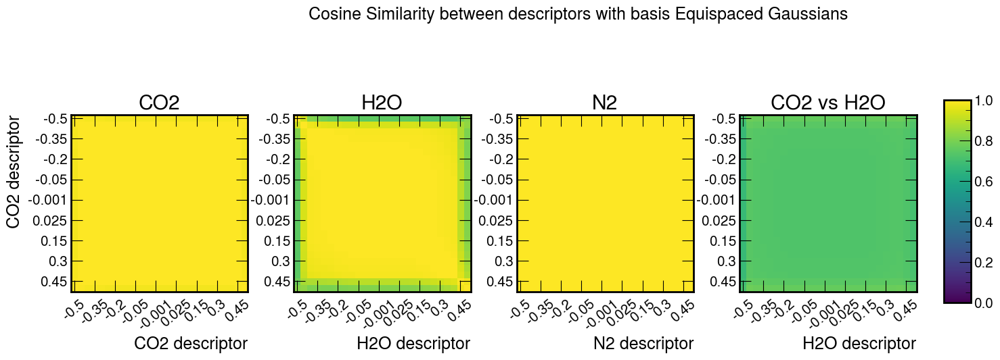

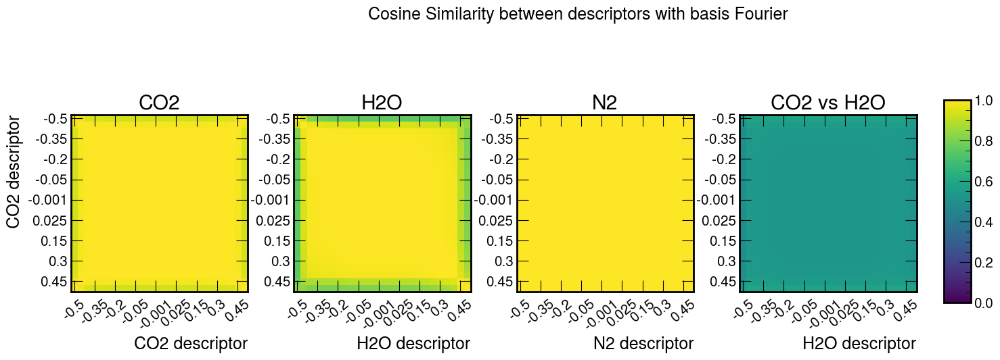

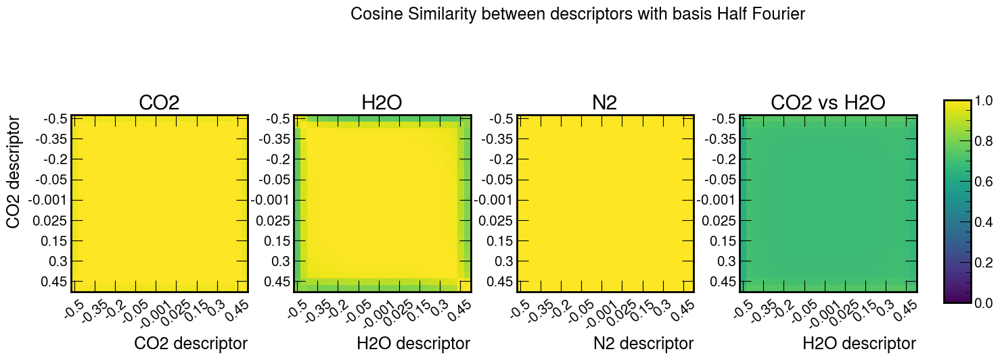

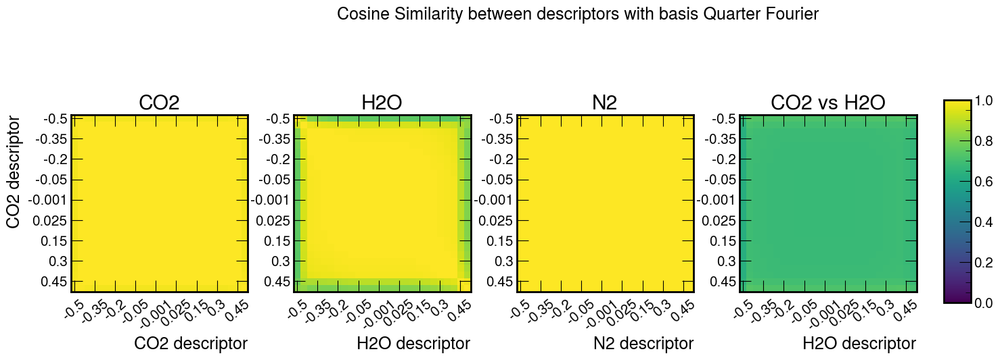

In [150]:
#Make the cosine similarity plot

print(nudge_array)
for i,basis in enumerate(bases):
    descriptors = {"N2":{},"CO2":{},"H2O":{}}
    cutoff = cutoff_array[0]
    for mol in ["CO2","H2O","N2"]:
    
        descriptors[mol] = []
        for j,L_max in enumerate([3]):
            for k,N_max in enumerate([10]):

                for nudge in nudge_array:
                    filename = ace_directory+"norm_alignment_angle_"+str(nudge*1000.0).split(".")[0]+"_"+mol+"_"+basis+"_0_"+str(cutoff)+"_Nmax_"+str(N_max)+"_Lmax_"+str(L_max)+"_cutoff_"+str(cutoff)+".npz"
                    descriptors[mol].append(np.load(filename)["ACE"][0])
                    
    #print(condition_matrix)
    title = "Cosine Similarity between descriptors with basis "+bases_titles[i]
    savename = ("CosineSimilarity_AlignmentAngle_%s_L_%s_N_%s" %(basis,str(L_max),str(N_max)))
    cosine_similarity_heatmap(descriptors,squish_array,["N2"],title,savename,"./Figures_v2/")

In [285]:
# Calculate derivatives magnitude
cutoff = cutoff_array[0]
plot = True
bond_radius = {"N2":[]}
for mol in ["N2"]:
    for j,L_max in enumerate(L_max_array):
        bond_radius[mol].append([])
        for k,N_max in enumerate(N_max_array):
            bond_radius[mol][j].append([])
            for i,basis in enumerate(bases):
                radius_array = np.zeros(len(squish_array))
                bond_radius[mol][j][k].append([]) 
                for squish in squish_array:
                    comparison_xyz = ase.io.read(xyz_directory+"bond_delta_"+str(squish*1000.0).split(".")[0]+"_"+mol+".extxyz")
                    bond_radius[mol][j][k][i].append(calc_distance(comparison_xyz.positions))

    
    #conditioning_matrix,delta_array,global_title,subtitles,savename,savepath
    if plot:
        for j,L_max in enumerate(L_max_array):
            for k,N_max in enumerate(N_max_array):
                plt.ioff()
                plot_derivatives_v3(bond_radius[mol][j][k][:],bases,N_max,cutoff,squish_array,"Basis derivatives: "+mol+" L_max:"+str(L_max) +", N_max:"+str(N_max),bases_titles,"Derivatives_BD_v3_"+mol+"_"+str(L_max) +"_"+str(N_max)+"_"+str(cutoff),"./Figures_v3/")
                plt.ion()

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 1.097, 1.099, 1.108, 1.123, 1.148, 1.198, 1.248, 1.298, 1.348, 1.398, 1.448, 1.498, 1.548, 1.598]
[0.598, 0.648, 0.698, 0.748, 0.798, 0.848, 0.898, 0.948, 0.998, 1.048, 1.073, 1.088, 

In [286]:
# Calculate derivatives magnitude
cutoff = cutoff_array[0]
plot = True
bond_radius = {"N2":[]}
for mol in ["N2"]:
    for j,L_max in enumerate(L_max_array):
        bond_radius[mol].append([])
        for k,N_max in enumerate(N_max_array):
            bond_radius[mol][j].append([])
            for i,basis in enumerate(bases):
                radius_array = np.zeros(len(nudge_array))
                bond_radius[mol][j][k].append([]) 
                for nudge in nudge_array:
                    comparison_xyz = ase.io.read(xyz_directory+"alignment_angle_"+str(nudge*1000.0).split(".")[0]+"_"+mol+".extxyz")
                    bond_radius[mol][j][k][i].append(calc_distance(comparison_xyz.positions))

    
    #conditioning_matrix,delta_array,global_title,subtitles,savename,savepath
    if plot:
        for j,L_max in enumerate(L_max_array):
            for k,N_max in enumerate(N_max_array):
                plt.ioff()
                plot_derivatives_v3(bond_radius[mol][j][k][:],bases,N_max,cutoff,nudge_array,"Basis derivatives: "+mol+" L_max:"+str(L_max) +", N_max:"+str(N_max),bases_titles,"Derivatives_AA_v3_"+mol+"_"+str(L_max) +"_"+str(N_max)+"_"+str(cutoff),"./Figures_v3/")
                plt.ion()

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/2628190024.py:272: RuntimeWarning: divide by zero encountered in scalar power
  basis_derivs[n] = n*x**(n-1)
/var/folders/p5/bvpl53mn15v55f8v1vwk1fz80000gp/T/ipykernel_11047/2628190024.py:272: RuntimeWarning: invalid value encountered in scalar multiply
  basis_derivs[n] = n*x**(n-1)


[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461, 1.3096237199999998, 1.34476987, 1.49989589, 1.5528065]
[0.0, 0.4018958899999999, 0.77640325, 0.83432232, 0.89065321, 0.9452887000000001, 0.9981247700000001, 1.04906086, 1.0786700299999998, 1.09608196, 1.09704139, 1.09752081, 1.09780834, 1.09819162, 1.09847899, 1.09895777, 1.0999147, 1.11699551, 1.14484904, 1.1895187900000002, 1.23192422, 1.27198461,

# Plot the derivatives alone:


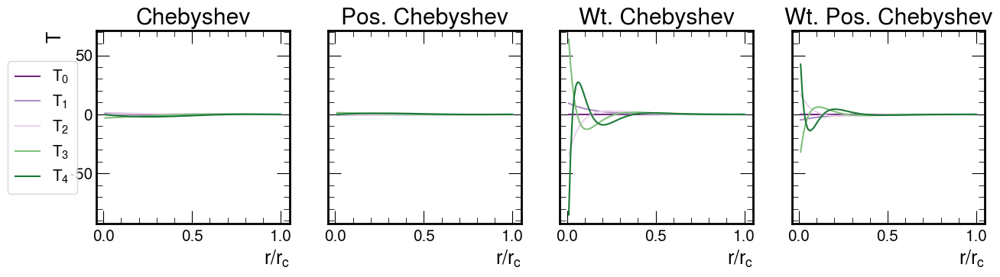

In [310]:
functions = [chebyshev, positive_chebyshev, weighted_chebyshev, weighted_positive_chebyshev]
titles = ['Chebyshev', 'Pos. Chebyshev', 'Wt. Chebyshev', 'Wt. Pos. Chebyshev']
radial_hyps = [0, 1, 5]
plot_all(functions, titles, radial_hyps, True, '../Figures/cheby_derivs.png')

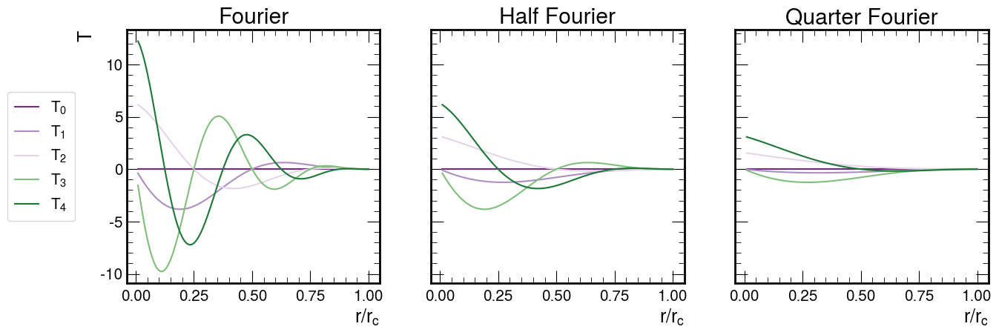

In [204]:
functions = [fourier, fourier_half, fourier_quarter]
titles = ['Fourier', 'Half Fourier', 'Quarter Fourier']
radial_hyps = [0, 1, 2]
plot_all(functions, titles, radial_hyps, True, '../Figures/fourier_derivs.png')

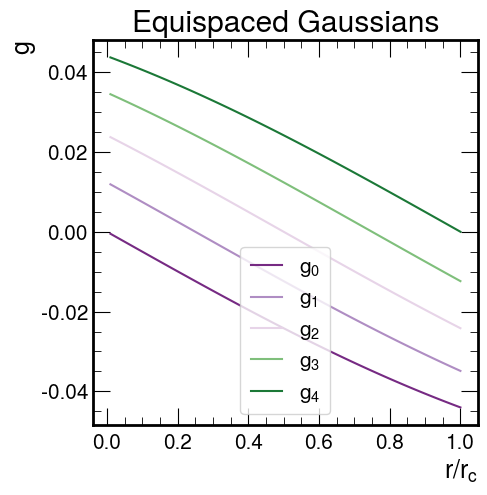

In [206]:
colors = ['#762a83', '#af8dc3', '#e7d4e8', '#7fbf7b', '#1b7837' ]

xarr, basis_derivs, rcut_vals = compute_basis_derivs(100, 5, 1, equispaced_gaussians, radial_hyps)
_, ax = plt.subplots(1, 1, sharey=True, figsize = (5, 5))
for i, c in zip(np.arange(0, 5), colors ):
    ax.plot(xarr, basis_derivs[i,:], label = '$g_%s$'%(i), color = c)
    ax.set_title('Equispaced Gaussians')
    ax.set_xlabel('$r/r_c$')
    ax.set_aspect(1.0/ax.get_data_ratio(), adjustable='box')
        
    
ax.legend(loc='lower center', ncol=1, frameon=True)
ax.set_ylabel('g') 
plt.savefig('../Figures/equispaced_derivs.png')
plt.show()

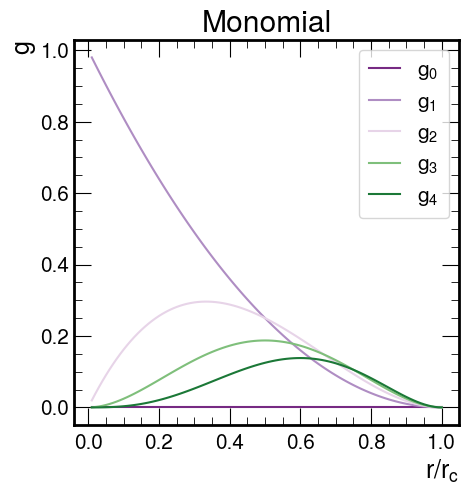

In [309]:

colors = ['#762a83', '#af8dc3', '#e7d4e8', '#7fbf7b', '#1b7837' ]

xarr, basis_derivs, rcut_vals = compute_basis_derivs(100, 100, 1, poly, radial_hyps)
_, ax = plt.subplots(1, 1, sharey=True, figsize = (5, 5))
for i, c in zip(np.arange(0, 5), colors ):
    ax.plot(xarr, basis_derivs[i,:]*rcut_vals[0,:], label = '$g_%s$'%(i), color = c)
    ax.set_title('Monomial')
    ax.set_xlabel('$r/r_c$')
    ax.set_aspect(1.0/ax.get_data_ratio(), adjustable='box')
        
    
ax.legend(loc='upper right', ncol=1, frameon=True)
ax.set_ylabel('g') 
plt.savefig('../Figures/poly_derivs.png')
plt.show()